# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [8]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = sum((1 - gradient_norm)**2)/len(gradient_norm)
    #### END CODE HERE ####
    return penalty

In [9]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [28]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -(torch.mean(crit_fake_pred))
    #### END CODE HERE ####
    return gen_loss

In [29]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [32]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [33]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.09023484795354307, critic loss: 1.899879008352757


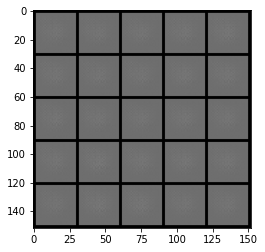

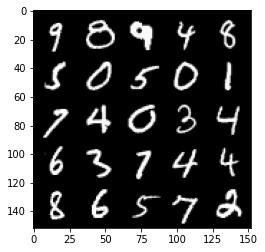

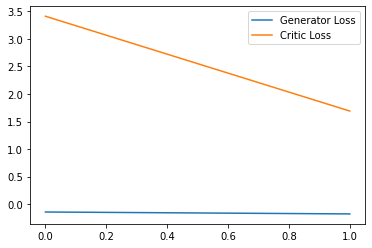

Step 100: Generator loss: 0.8388394767045975, critic loss: -1.7524804191291334


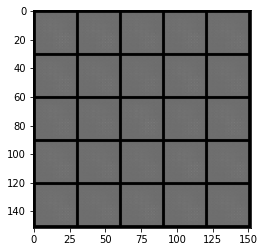

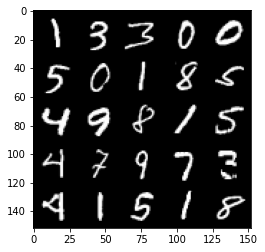

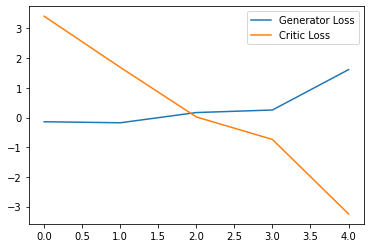

Step 150: Generator loss: 2.6155189085006714, critic loss: -10.053008983612061


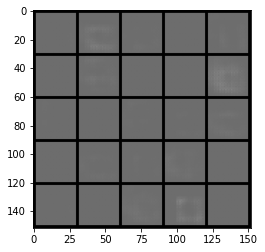

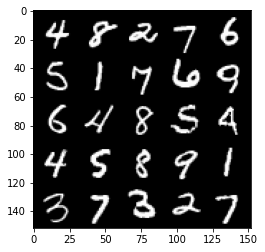

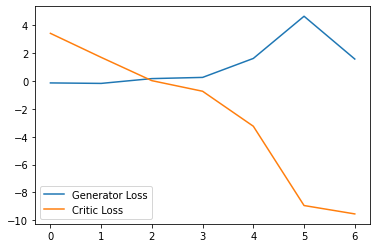

Step 200: Generator loss: 0.3569762894511223, critic loss: -24.46309864044189


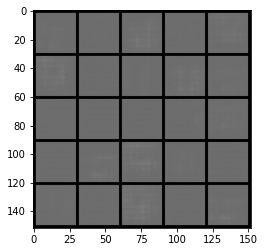

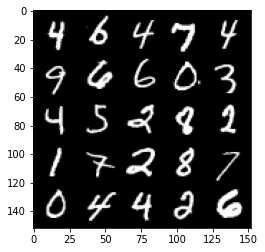

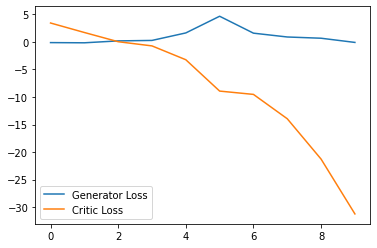

Step 250: Generator loss: -0.7766600826382637, critic loss: -54.76633037567138


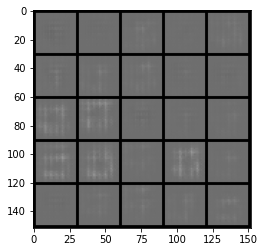

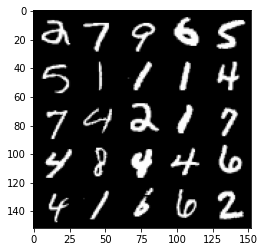

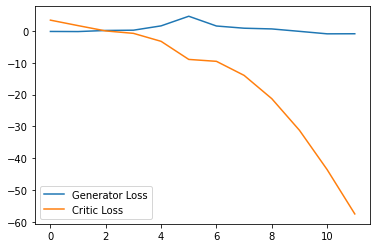

Step 300: Generator loss: 2.6016446924209595, critic loss: -97.6831575317383


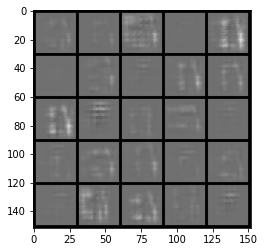

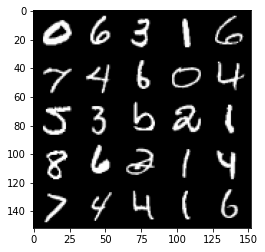

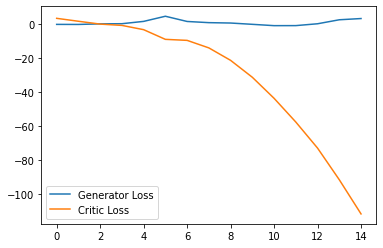

Step 350: Generator loss: 6.418876948356629, critic loss: -148.16825411987304


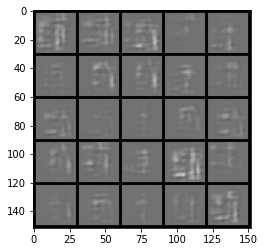

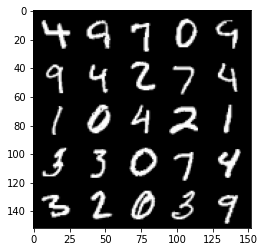

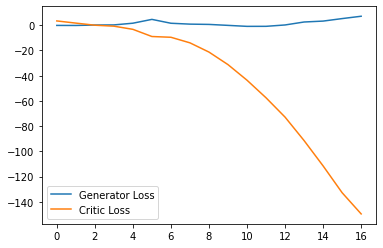

Step 400: Generator loss: 7.688171455860138, critic loss: -190.76821643066404


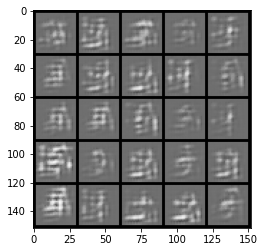

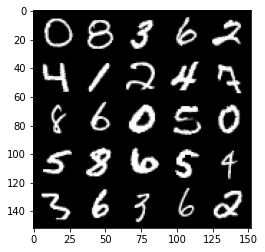

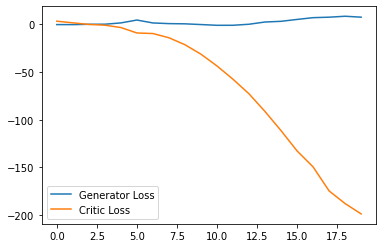

Step 450: Generator loss: -7.946700992584229, critic loss: -165.74356710815428


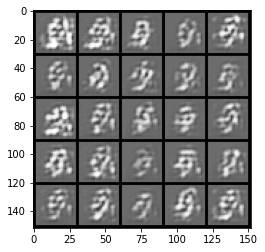

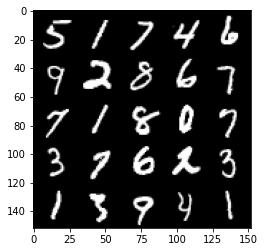

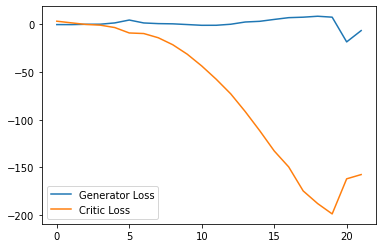

Step 500: Generator loss: 14.512002868652344, critic loss: -212.63924301147458


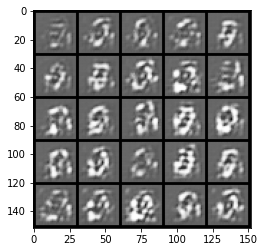

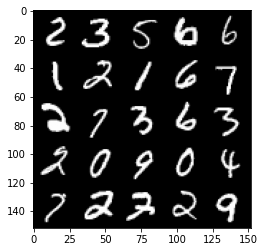

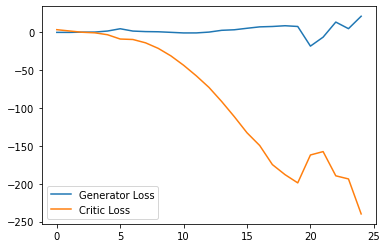

Step 550: Generator loss: 8.074997874498367, critic loss: -270.12660766601573


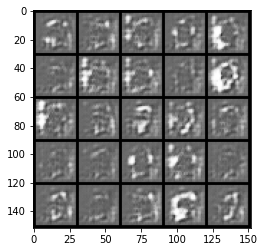

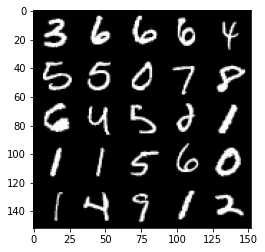

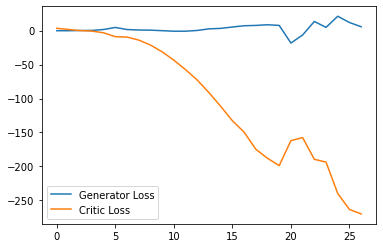

Step 600: Generator loss: -0.6293686646223068, critic loss: -319.0780582885742


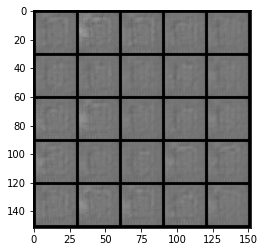

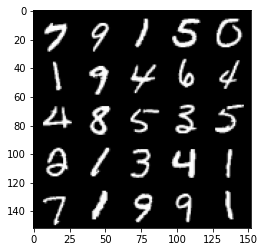

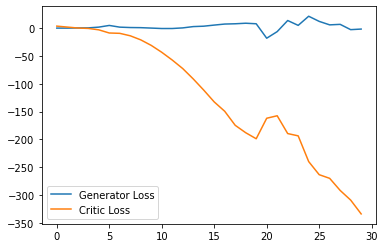

Step 650: Generator loss: 3.028246850669384, critic loss: -373.97128564453124


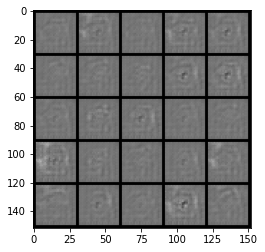

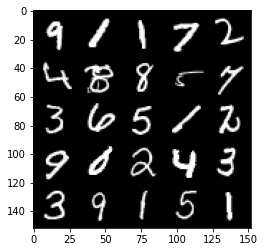

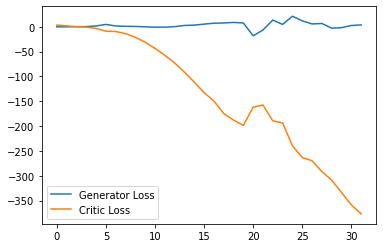

Step 700: Generator loss: 9.801859180927277, critic loss: -417.90311511230465


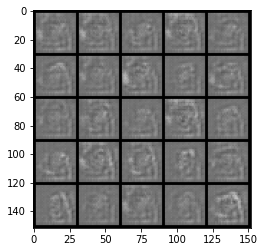

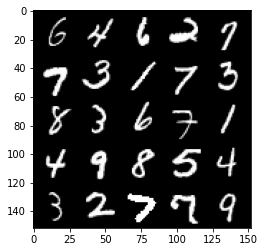

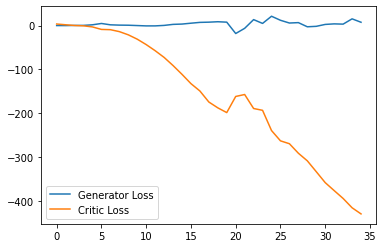

Step 750: Generator loss: -22.405863609313965, critic loss: -363.3913043365478


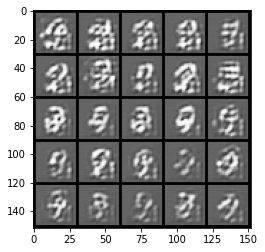

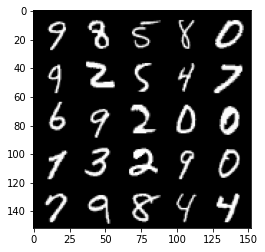

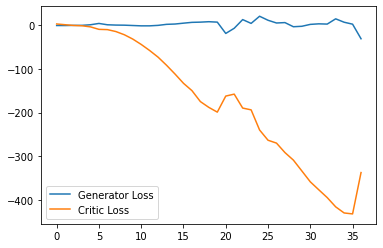

Step 800: Generator loss: -82.19490159034729, critic loss: -271.9817045288085


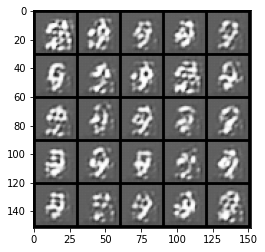

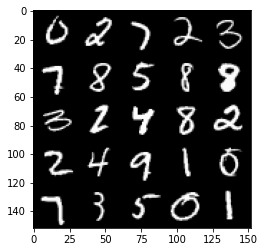

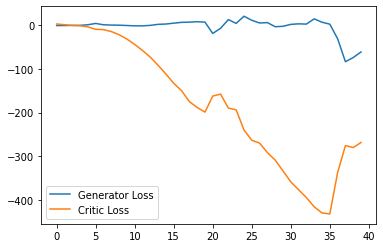

Step 850: Generator loss: 6.940125005245209, critic loss: -313.37819232177736


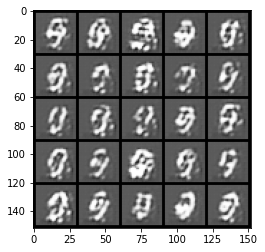

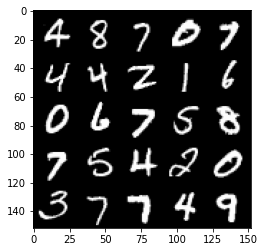

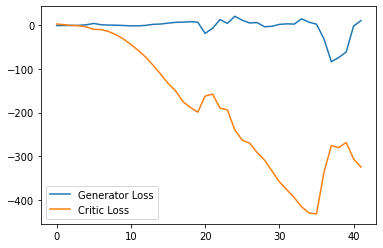

Step 900: Generator loss: 25.039935421943664, critic loss: -370.849480529785


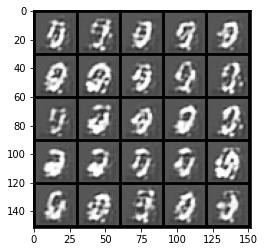

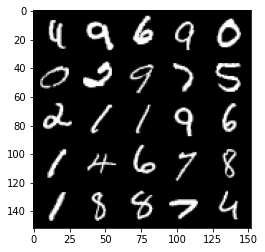

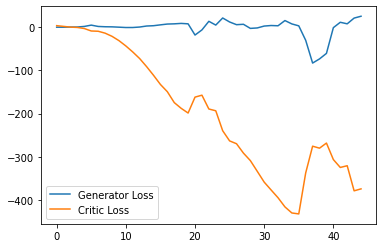

Step 950: Generator loss: -2.859728889465332, critic loss: -339.1710856933594


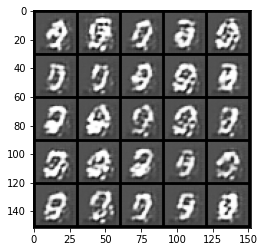

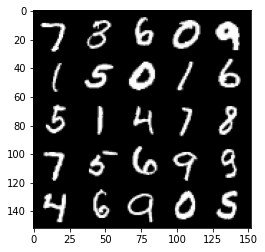

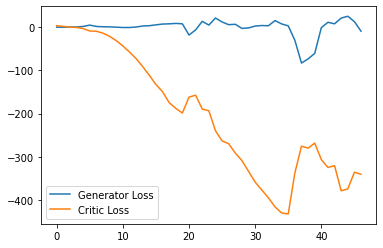

Step 1000: Generator loss: -16.96751456618309, critic loss: -244.72288342285165


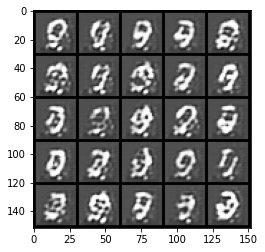

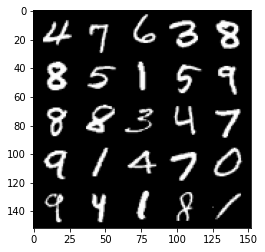

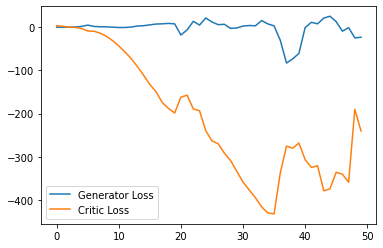

Step 1050: Generator loss: -19.865142065286637, critic loss: -281.23558450317387


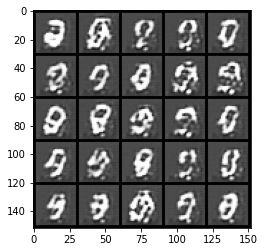

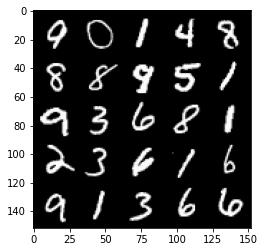

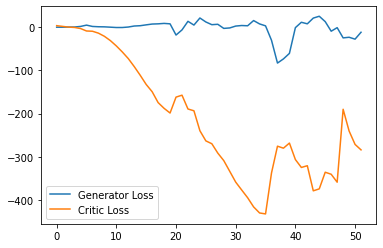

Step 1100: Generator loss: -7.08825621008873, critic loss: -276.36830465698245


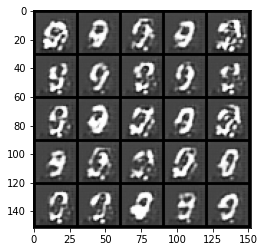

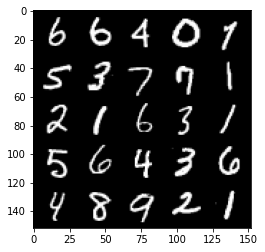

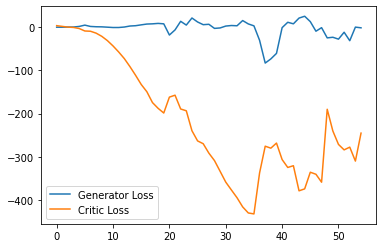

Step 1150: Generator loss: -46.12338161468506, critic loss: -244.3948073425293


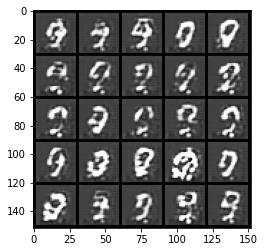

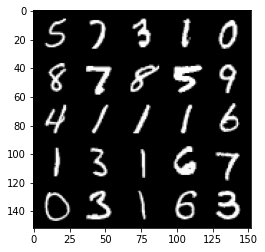

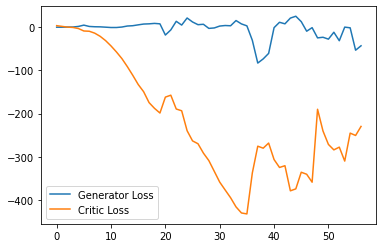

Step 1200: Generator loss: -15.010397520065307, critic loss: -144.66738889312742


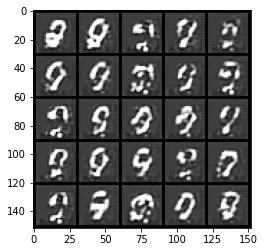

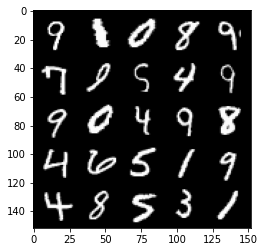

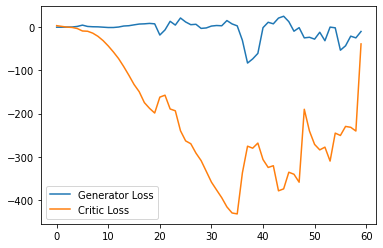

Step 1250: Generator loss: -25.911519963741302, critic loss: -71.38195350646973


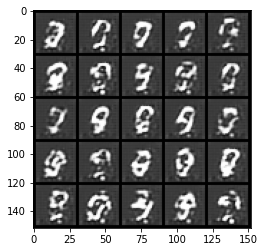

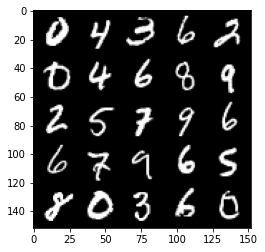

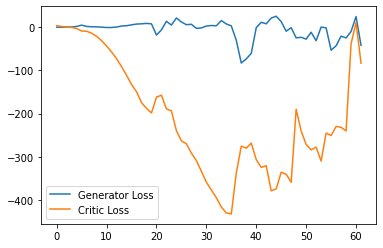

Step 1300: Generator loss: -72.159075756073, critic loss: -179.13077584838865


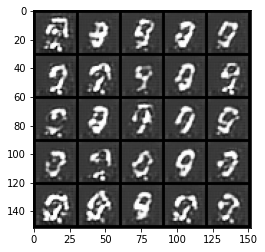

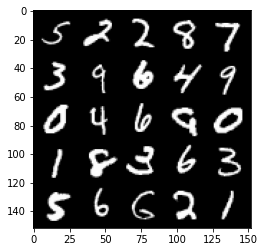

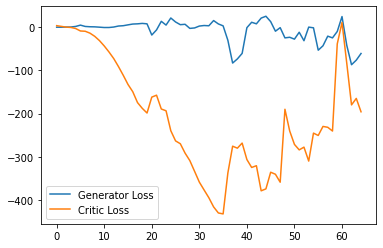

Step 1350: Generator loss: -56.39985874533653, critic loss: -179.16913690185552


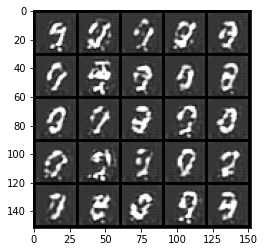

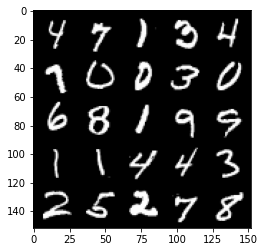

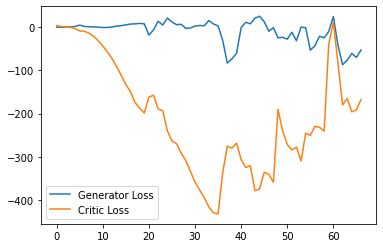

Step 1400: Generator loss: -69.69918473482132, critic loss: -170.6702903442383


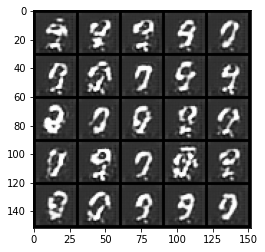

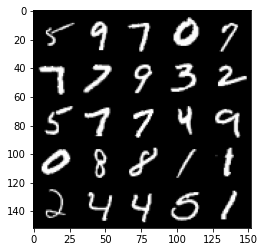

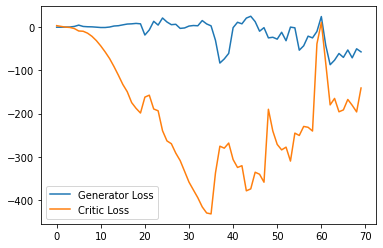

Step 1450: Generator loss: -45.790639481544495, critic loss: -65.416590927124


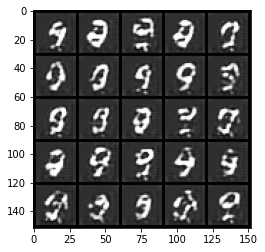

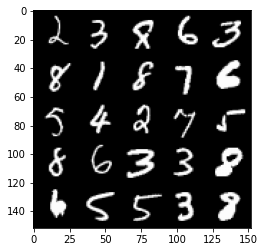

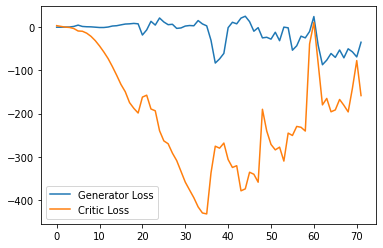

Step 1500: Generator loss: 8.867684020996094, critic loss: 20.090226806640626


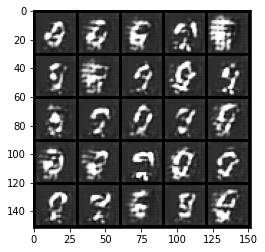

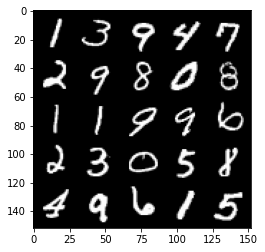

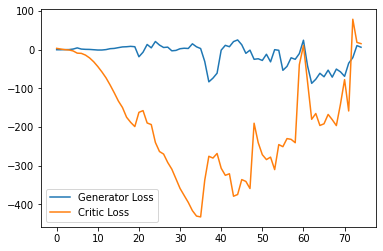

Step 1550: Generator loss: 4.2717662525177005, critic loss: 23.02469302368165


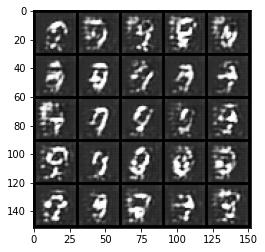

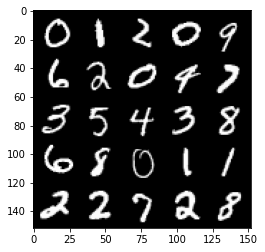

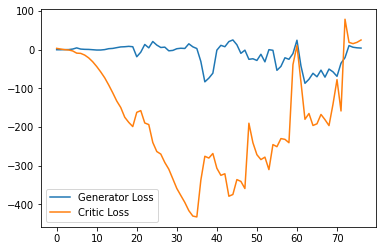

Step 1600: Generator loss: -0.39728743836283686, critic loss: 29.941163406372066


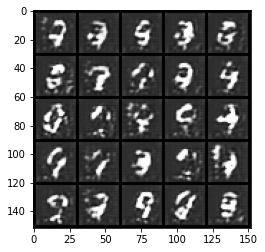

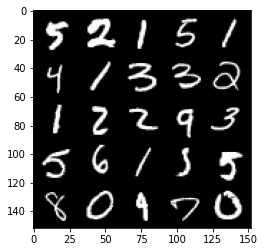

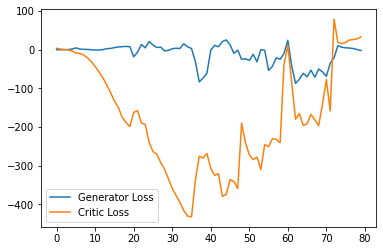

Step 1650: Generator loss: -4.895655574798584, critic loss: 35.54110410308838


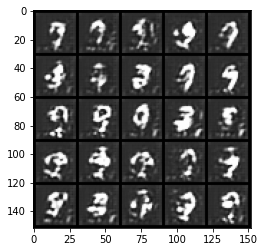

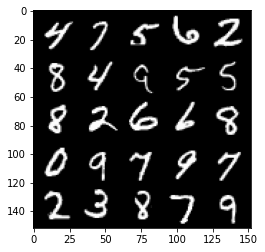

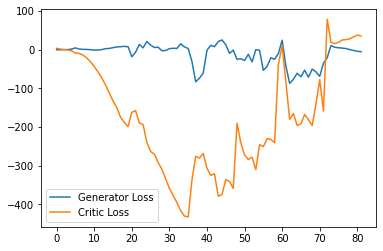

Step 1700: Generator loss: -5.778394832611084, critic loss: 27.076315612792964


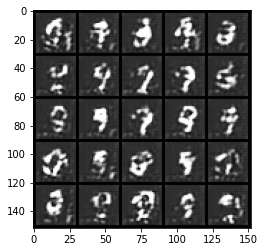

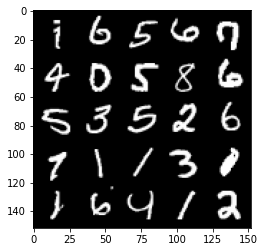

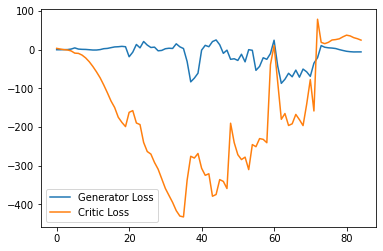

Step 1750: Generator loss: -6.189607706069946, critic loss: 18.561078134536743


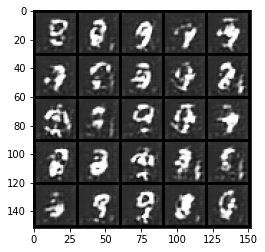

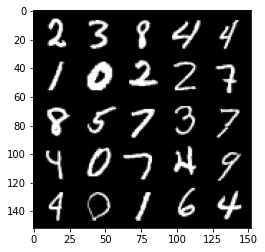

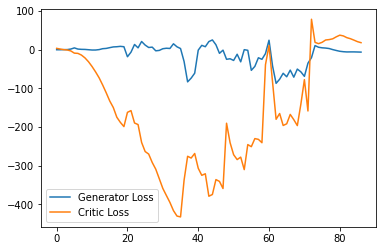

Step 1800: Generator loss: -6.676863451004028, critic loss: 13.802520149230954


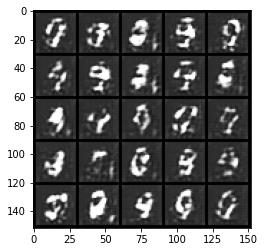

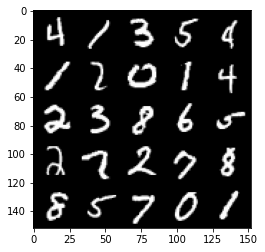

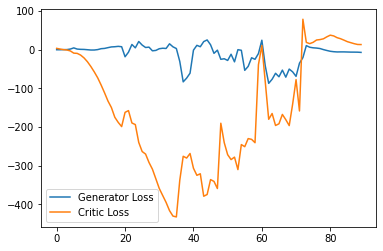

Step 1850: Generator loss: -7.783194971084595, critic loss: 13.534674823760986


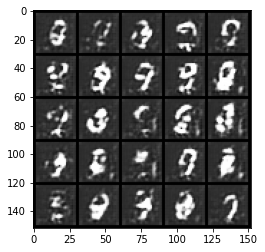

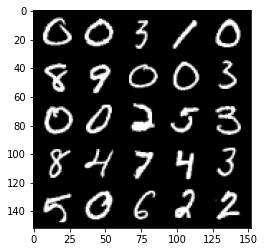

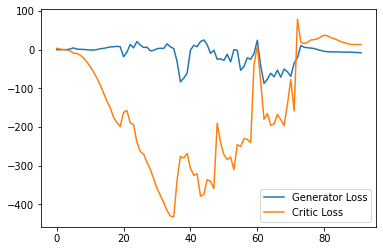

Step 1900: Generator loss: -9.461913185119629, critic loss: 14.462517808914187


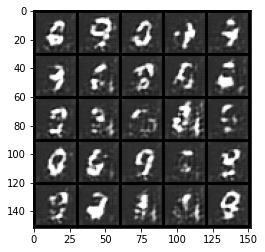

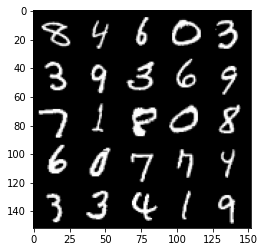

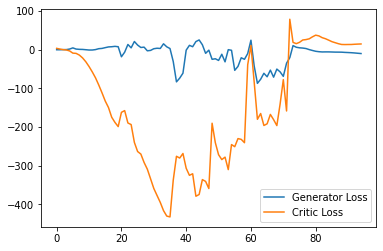

Step 1950: Generator loss: -11.320411205291748, critic loss: 16.14072716522217


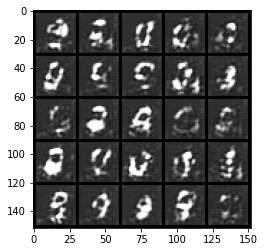

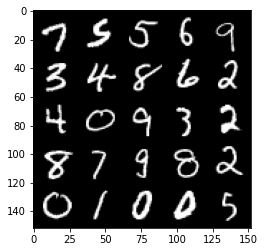

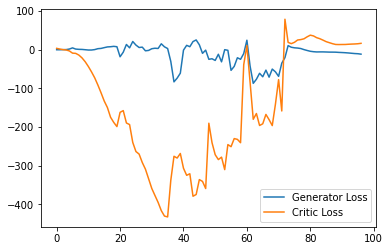

Step 2000: Generator loss: -13.358297901153565, critic loss: 11.78932146453857


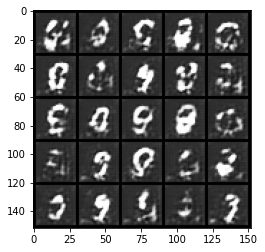

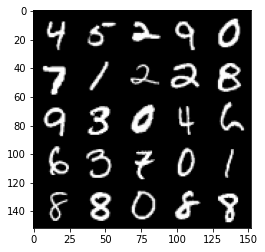

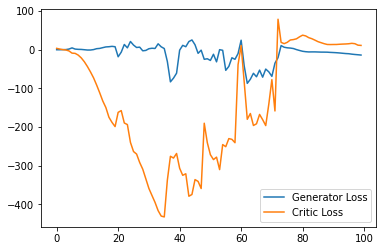

Step 2050: Generator loss: -15.961993217468262, critic loss: 8.986586107254025


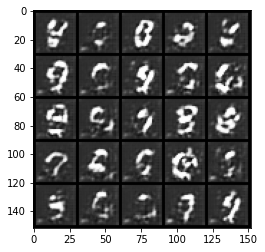

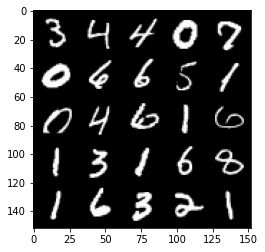

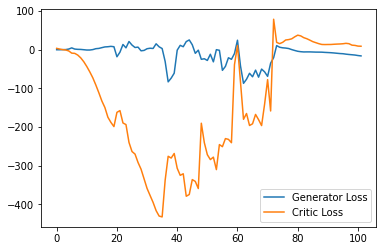

Step 2100: Generator loss: -17.756806526184082, critic loss: 7.729904607772828


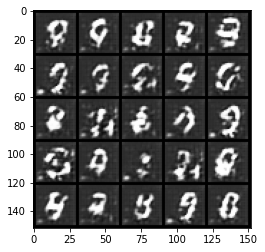

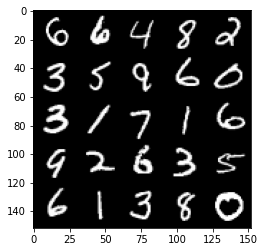

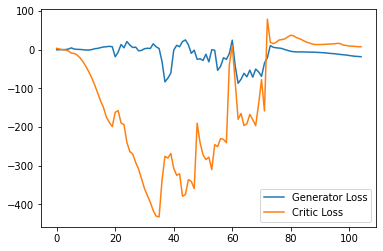

Step 2150: Generator loss: -19.042489700317383, critic loss: 5.148612283706665


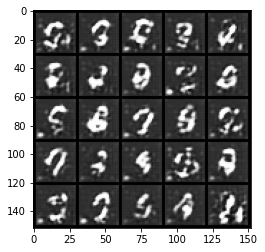

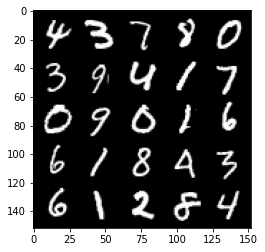

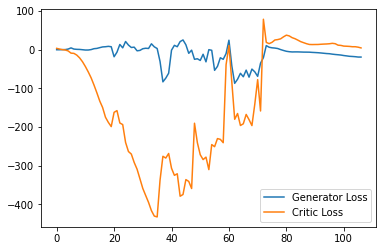

Step 2200: Generator loss: -19.164731979370117, critic loss: 2.7365854778289798


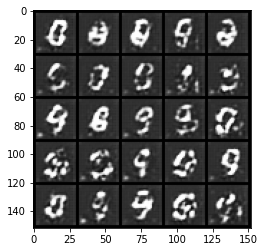

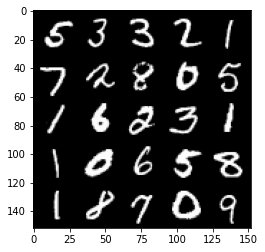

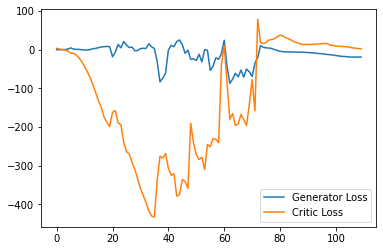

Step 2250: Generator loss: -19.21930503845215, critic loss: 0.9828563003540036


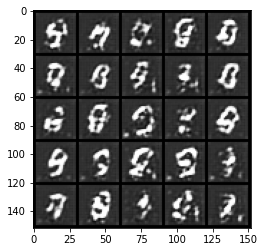

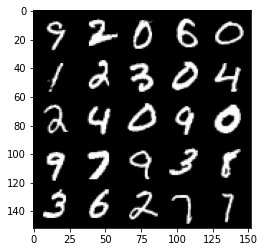

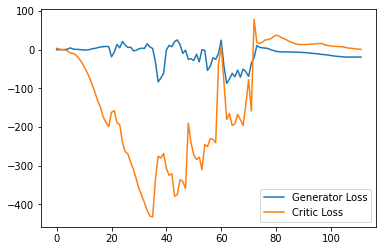

Step 2300: Generator loss: -20.012280960083007, critic loss: -0.6176912956237792


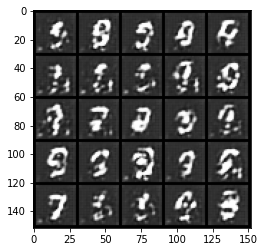

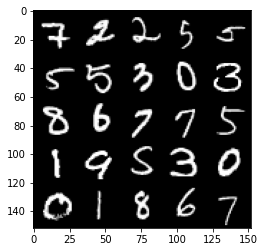

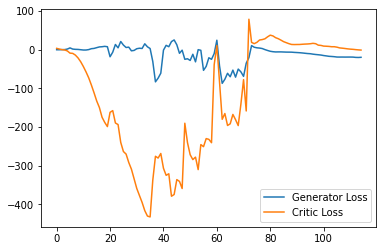

Step 2350: Generator loss: -20.97546085357666, critic loss: -2.668627481460571


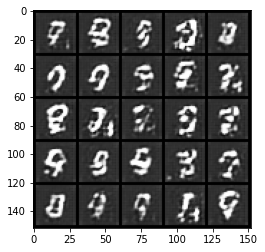

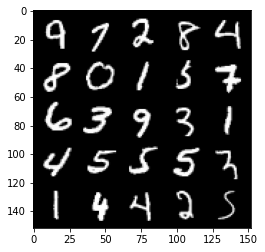

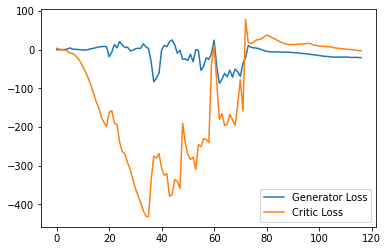

Step 2400: Generator loss: -22.709963207244872, critic loss: -4.3075349445343


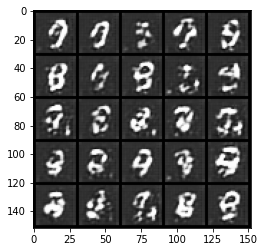

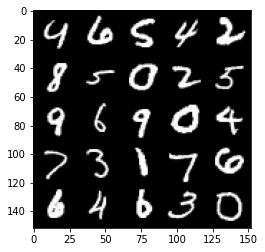

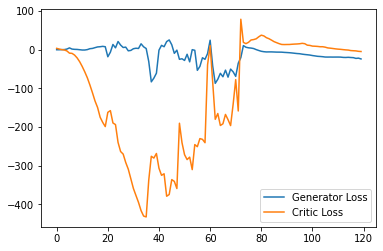

Step 2450: Generator loss: -26.433125438690187, critic loss: -8.372657375335692


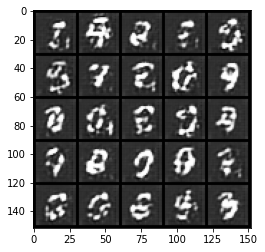

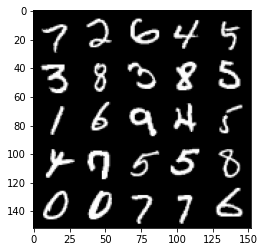

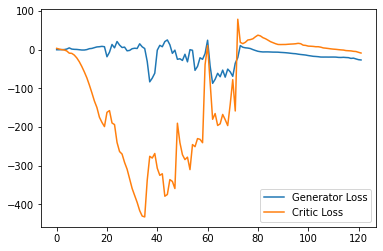

Step 2500: Generator loss: -27.24969902038574, critic loss: -12.450227783203127


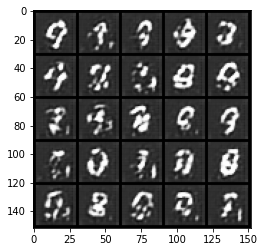

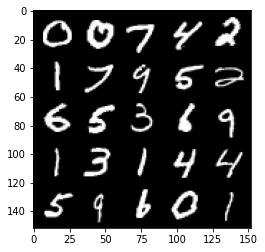

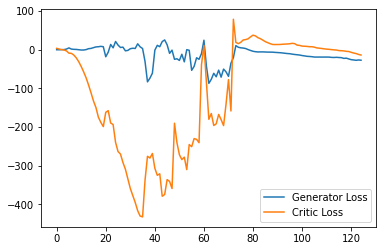

Step 2550: Generator loss: -32.39726556777954, critic loss: -15.343646377563475


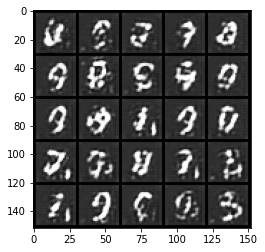

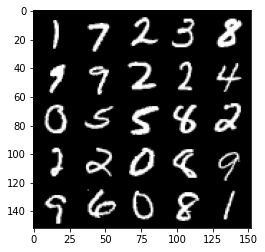

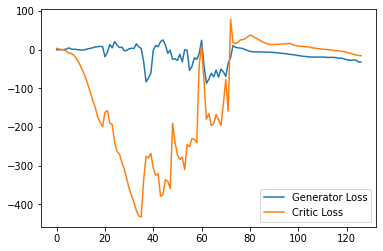

Step 2600: Generator loss: -32.105220336914066, critic loss: -20.083965587615968


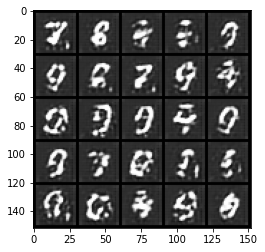

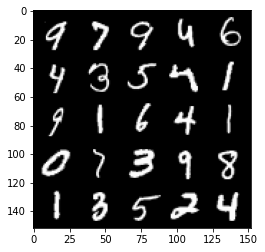

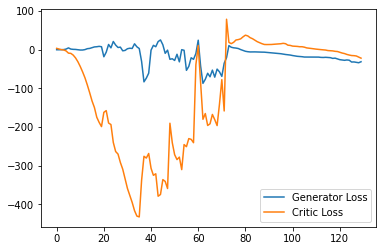

Step 2650: Generator loss: -36.14525875091553, critic loss: -21.65957218170166


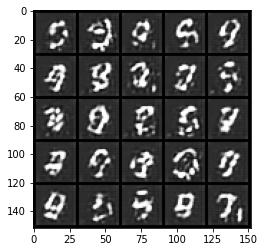

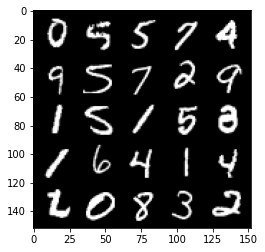

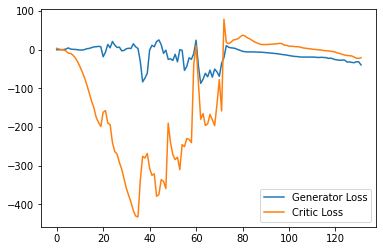

Step 2700: Generator loss: -36.28907787322998, critic loss: -25.36129788208008


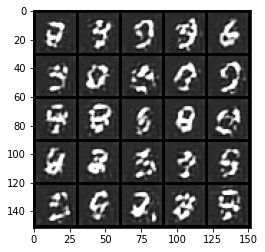

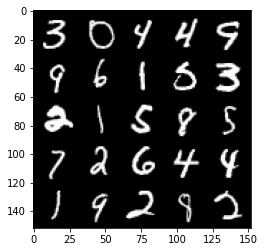

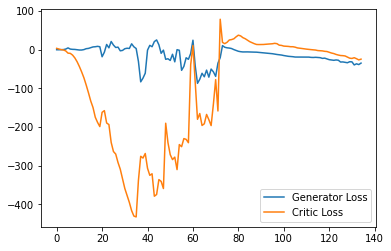

Step 2750: Generator loss: -39.66780366897583, critic loss: -25.442424873352046


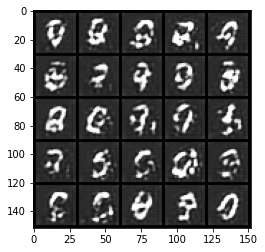

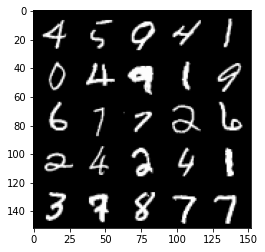

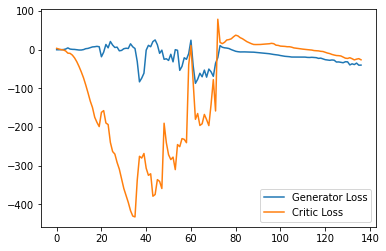

Step 2800: Generator loss: -36.12464756011963, critic loss: -28.53290729141236


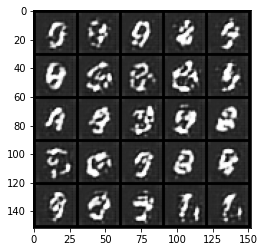

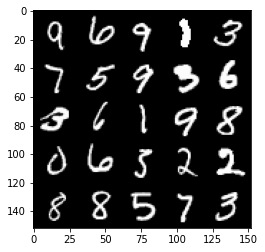

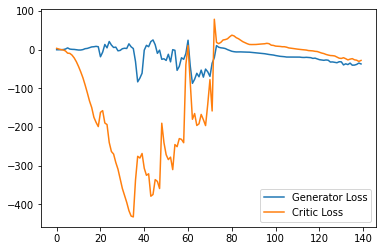

Step 2850: Generator loss: -41.10861583709717, critic loss: -27.6934446105957


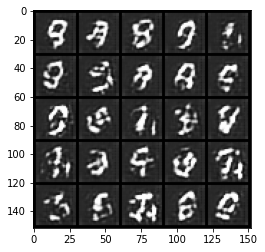

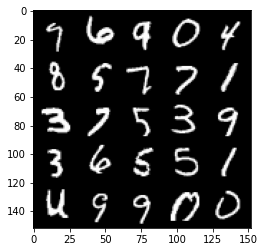

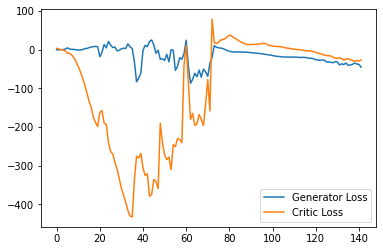

Step 2900: Generator loss: -39.43991600036621, critic loss: -29.68973285293579


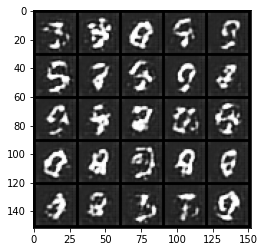

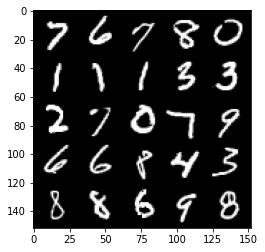

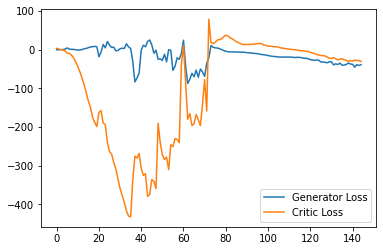

Step 2950: Generator loss: -42.48243907928467, critic loss: -24.672854593276973


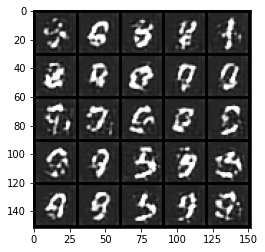

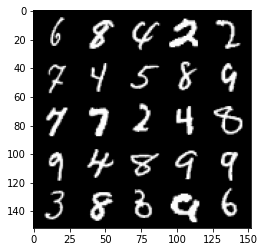

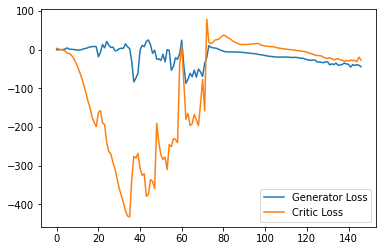

Step 3000: Generator loss: -42.35277053833008, critic loss: -25.60215636062622


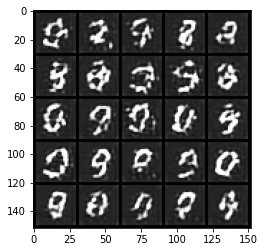

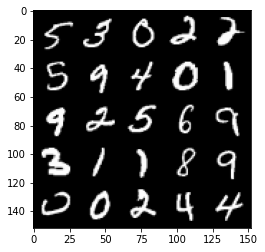

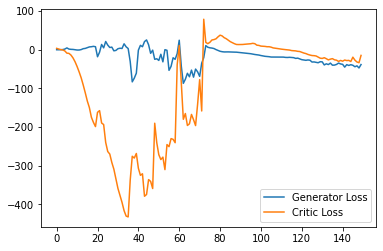

Step 3050: Generator loss: -46.995761985778806, critic loss: -28.73155484962463


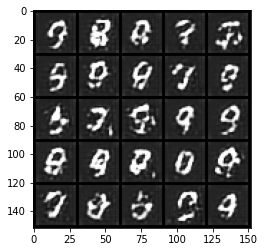

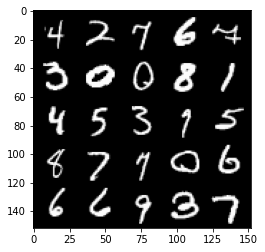

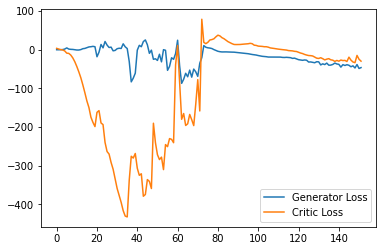

Step 3100: Generator loss: -44.365794553756714, critic loss: -27.543325258255


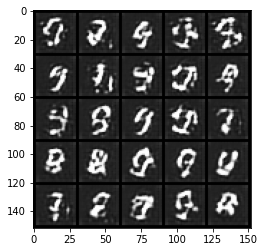

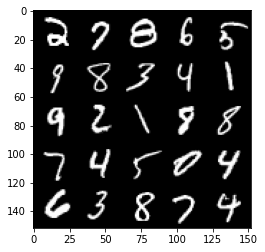

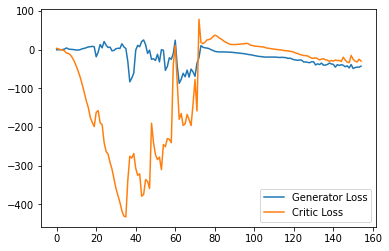

Step 3150: Generator loss: -46.730877532958985, critic loss: -28.662742549896237


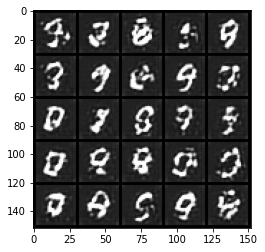

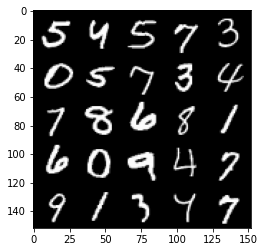

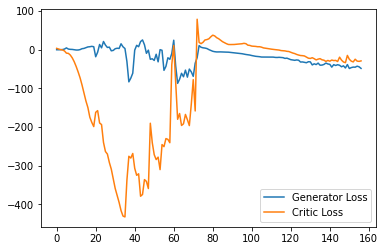

Step 3200: Generator loss: -44.39406600952148, critic loss: -22.467865066528315


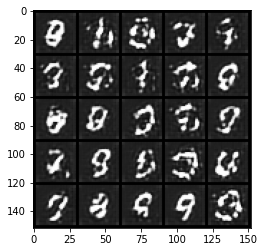

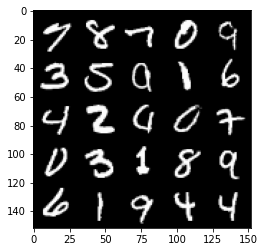

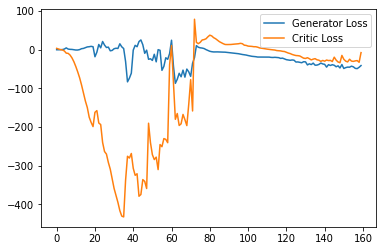

Step 3250: Generator loss: -50.32009696960449, critic loss: -27.007955423355106


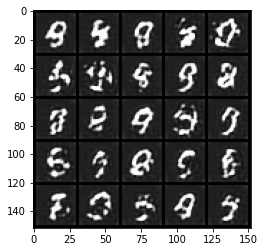

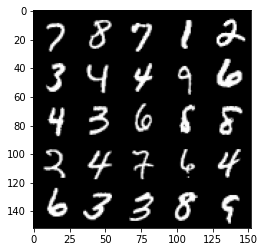

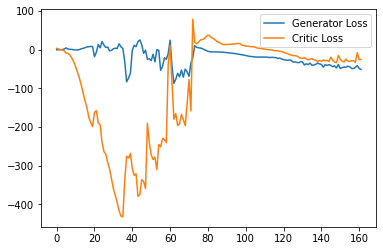

Step 3300: Generator loss: -47.31713508605957, critic loss: -27.840311002731323


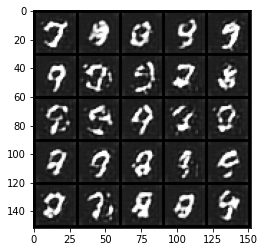

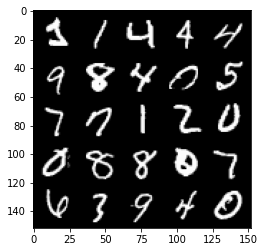

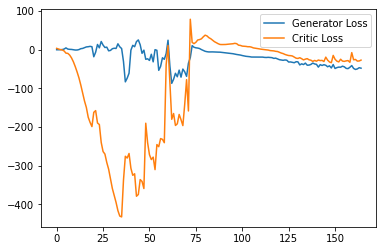

Step 3350: Generator loss: -45.68650634765625, critic loss: -24.022866128921507


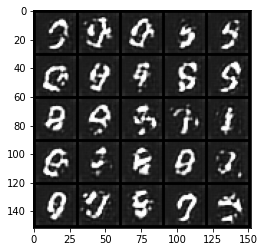

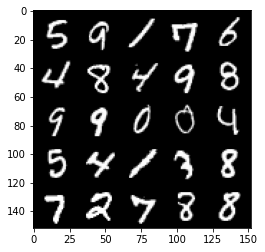

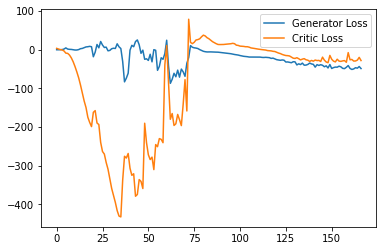

Step 3400: Generator loss: -47.696836624145504, critic loss: -28.144087120056156


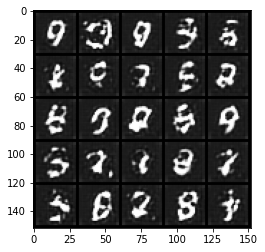

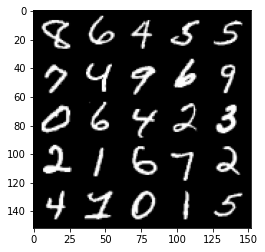

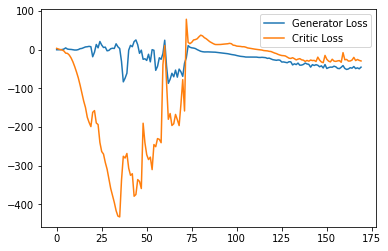

Step 3450: Generator loss: -45.372786865234374, critic loss: -14.540659461021418


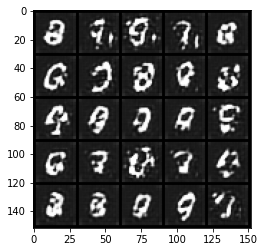

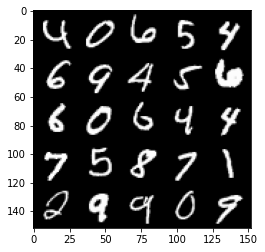

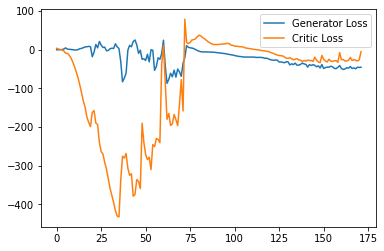

Step 3500: Generator loss: -51.82257553100586, critic loss: -24.571395755767824


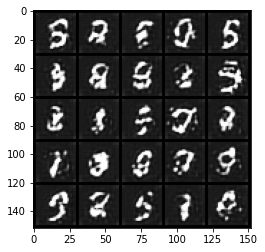

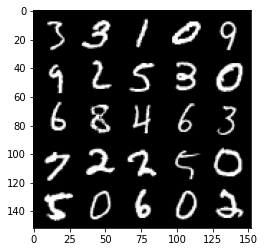

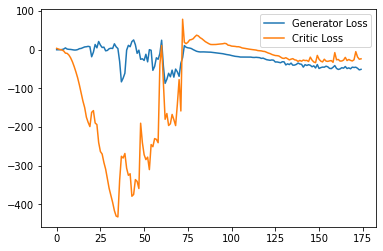

Step 3550: Generator loss: -50.0029887008667, critic loss: -24.802094298362736


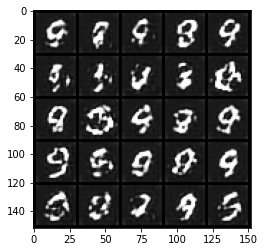

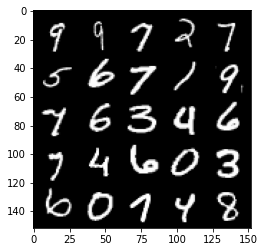

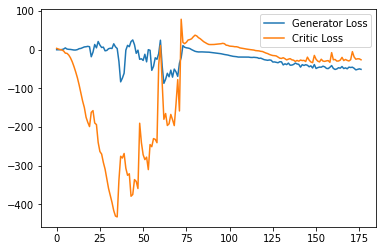

Step 3600: Generator loss: -52.05789924621582, critic loss: -24.589973760604856


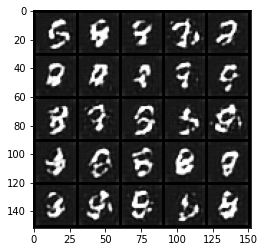

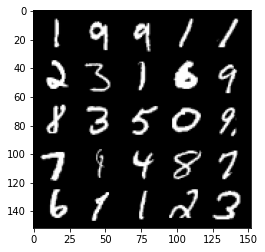

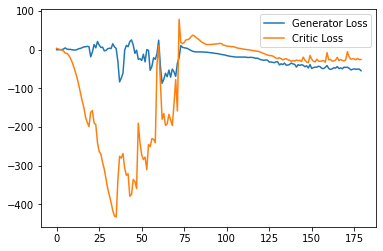

Step 3650: Generator loss: -50.27028099060058, critic loss: -20.28844200706482


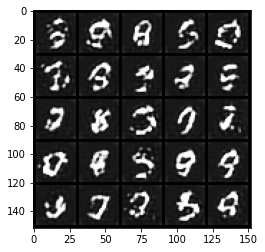

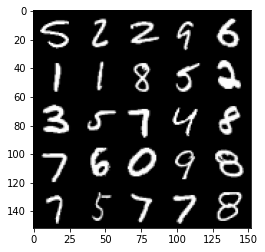

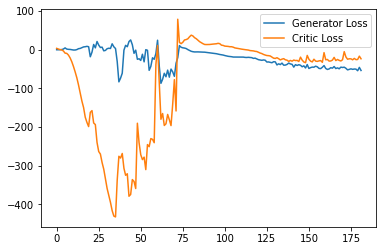

Step 3700: Generator loss: -41.161436538696286, critic loss: 0.012646859645844095


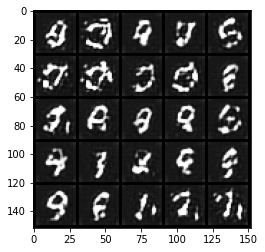

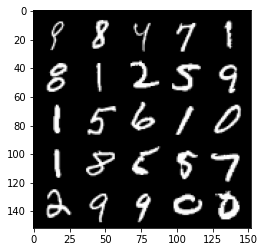

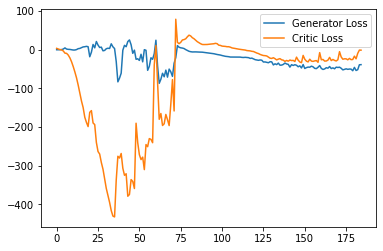

Step 3750: Generator loss: -41.303086013793944, critic loss: -1.5143191909790041


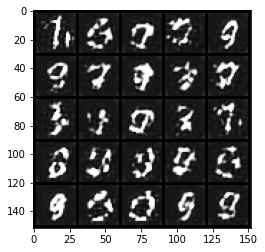

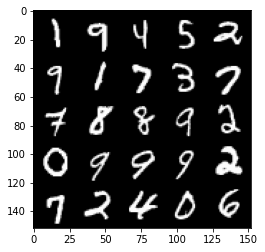

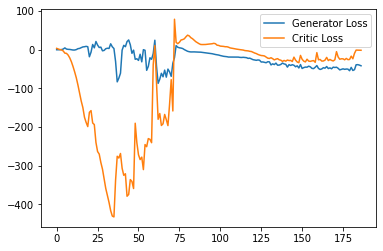

Step 3800: Generator loss: -52.82059509277344, critic loss: -15.965180680274965


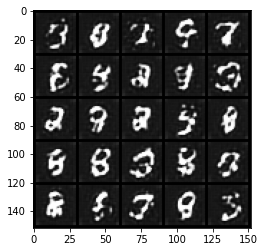

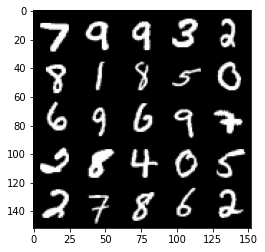

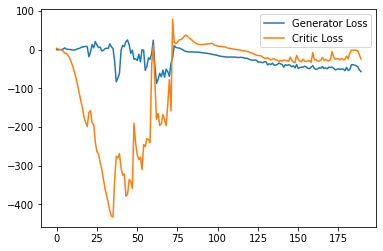

Step 3850: Generator loss: -50.1408154296875, critic loss: -12.16318917989731


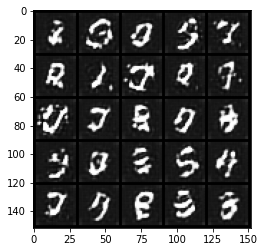

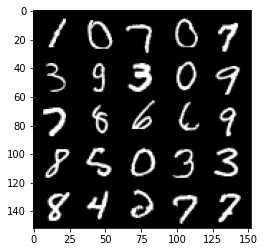

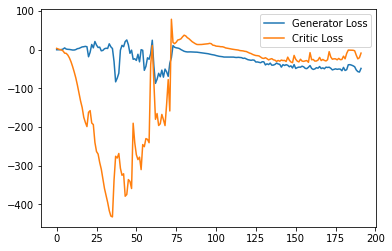

Step 3900: Generator loss: -43.75790367126465, critic loss: -8.719623641967774


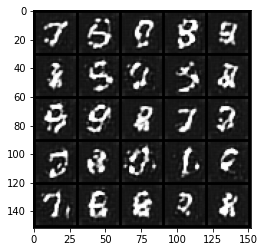

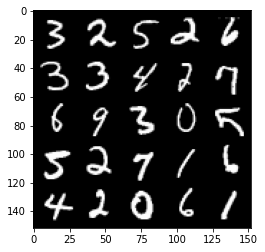

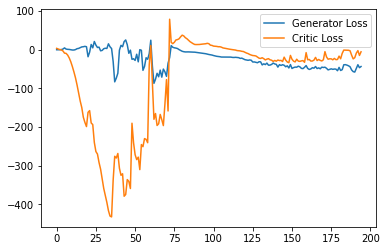

Step 3950: Generator loss: -48.64755649566651, critic loss: -17.779634479522706


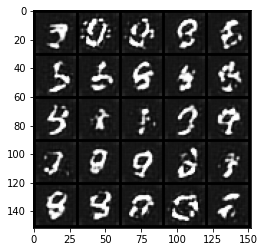

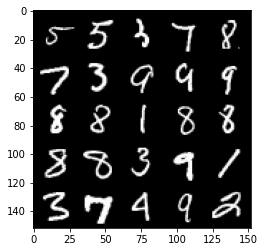

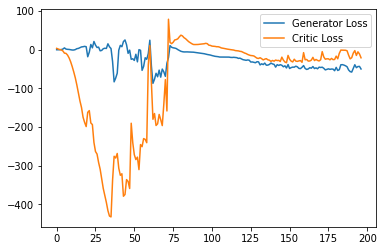

Step 4000: Generator loss: -50.780878677368165, critic loss: -20.616602903366086


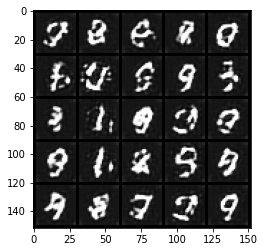

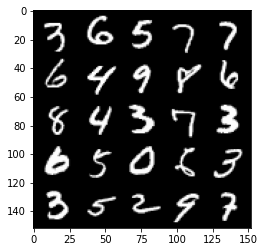

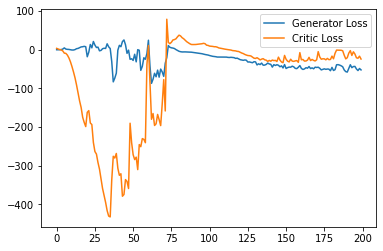

Step 4050: Generator loss: -50.274536323547366, critic loss: -21.450396646499634


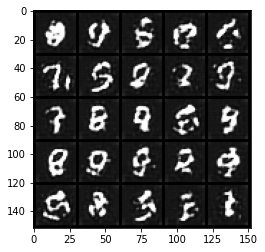

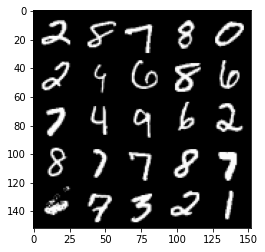

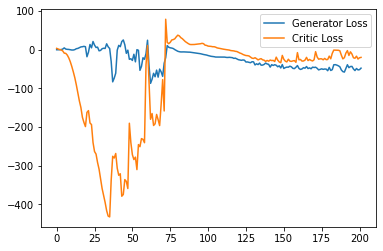

Step 4100: Generator loss: -43.55252477645874, critic loss: -14.58469393920898


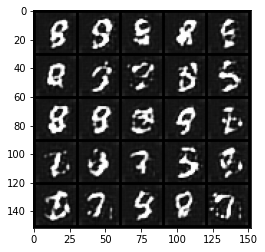

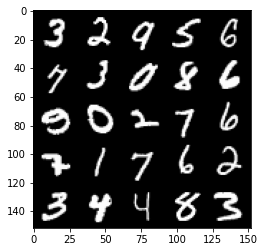

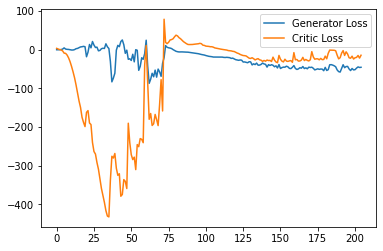

Step 4150: Generator loss: -33.84288299560547, critic loss: -1.6001444711685182


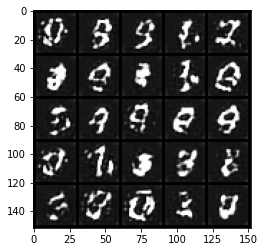

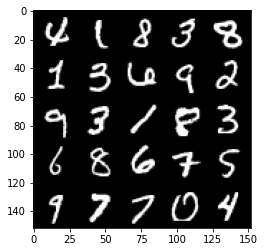

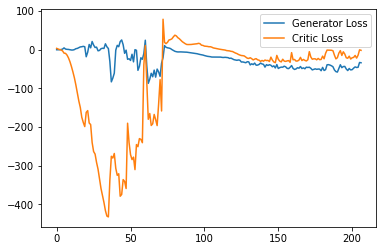

Step 4200: Generator loss: -36.93033409118652, critic loss: -2.438993955612183


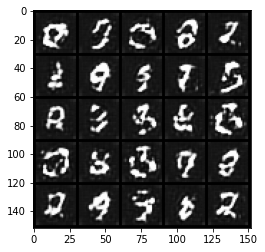

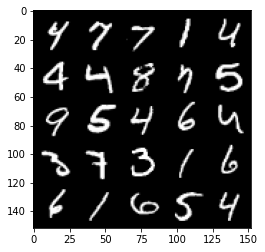

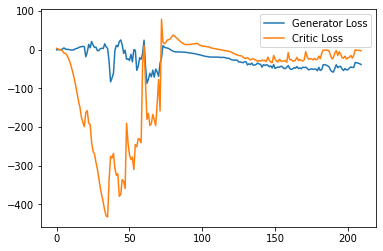

Step 4250: Generator loss: -46.79907272338867, critic loss: -14.567674398422241


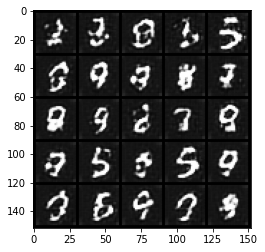

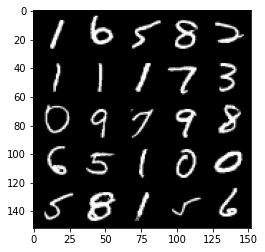

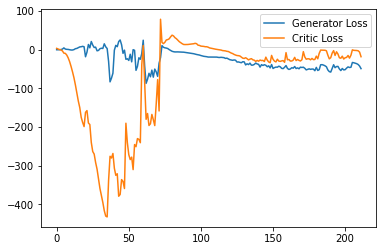

Step 4300: Generator loss: -36.68921901702881, critic loss: -1.8957768287658687


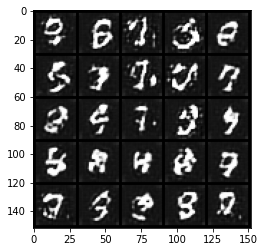

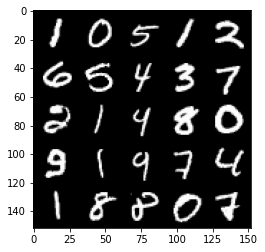

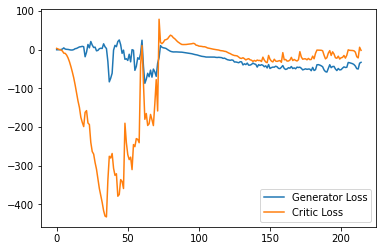

Step 4350: Generator loss: -35.98434844970703, critic loss: -2.1066093173027043


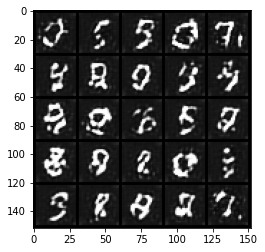

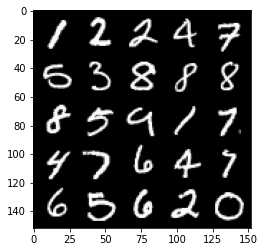

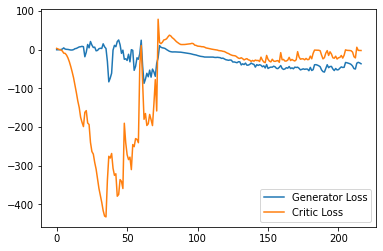

Step 4400: Generator loss: -42.1867879486084, critic loss: -6.574223388671873


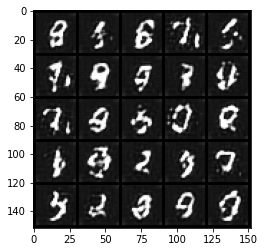

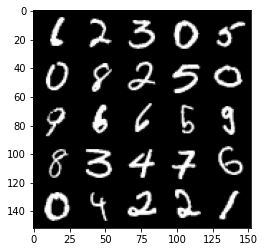

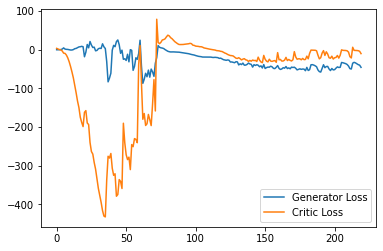

Step 4450: Generator loss: -50.15654731750488, critic loss: -20.322937426567083


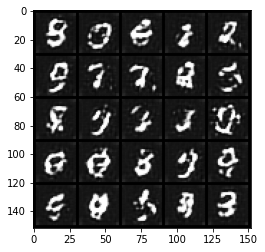

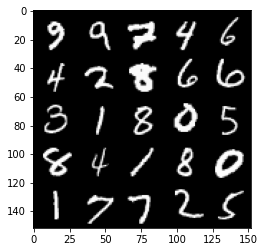

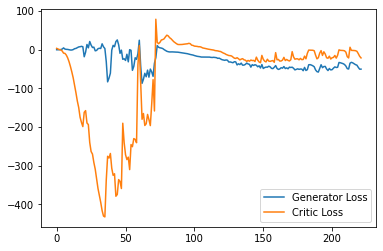

Step 4500: Generator loss: -45.294772453308106, critic loss: -18.59785010051727


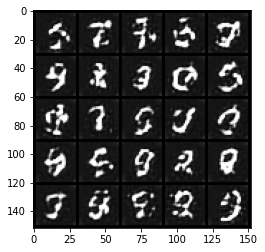

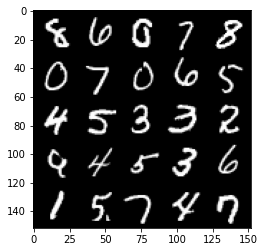

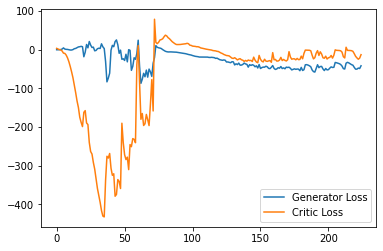

Step 4550: Generator loss: -45.710195503234864, critic loss: -21.770226696014397


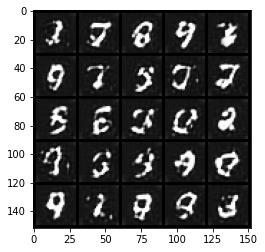

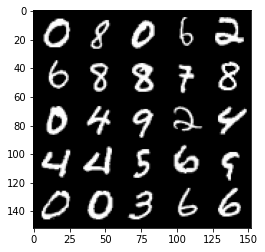

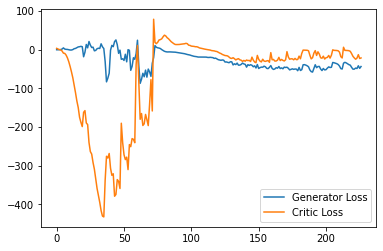

Step 4600: Generator loss: -45.64071792602539, critic loss: -20.183796411514283


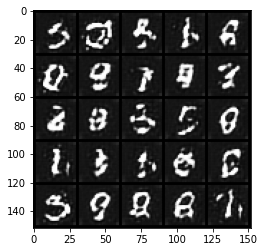

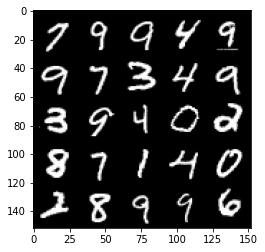

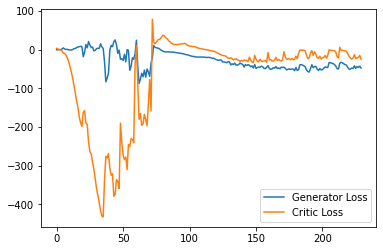

Step 4650: Generator loss: -43.57508102416992, critic loss: -22.17330084562302


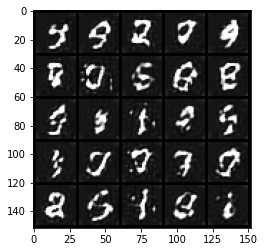

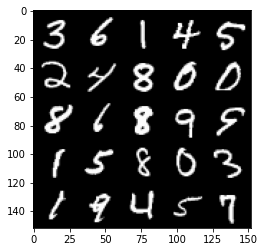

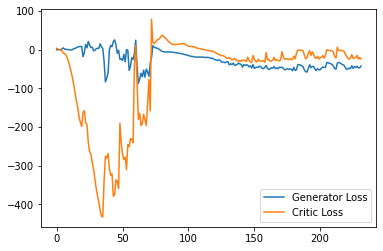

Step 4700: Generator loss: -40.014680824279786, critic loss: -11.01969862651825


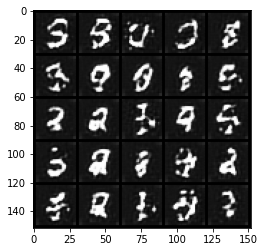

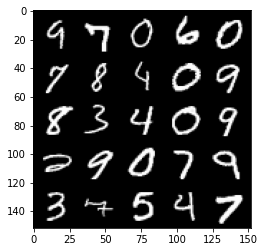

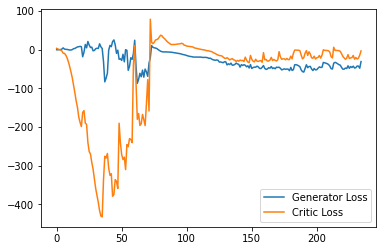

Step 4750: Generator loss: -42.39702007293701, critic loss: -13.173294968605042


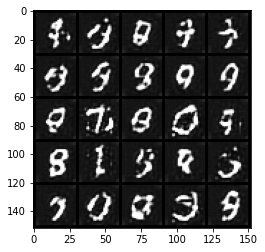

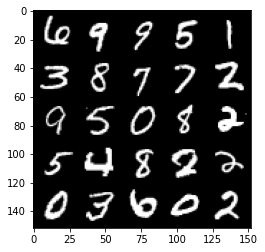

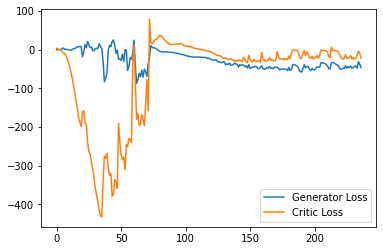

Step 4800: Generator loss: -35.16506477355957, critic loss: -7.956302251338958


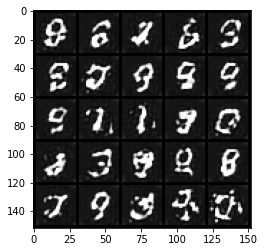

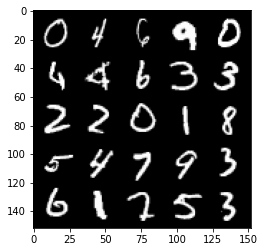

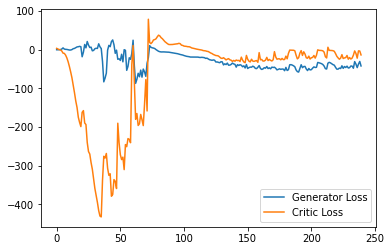

Step 4850: Generator loss: -42.98998527526855, critic loss: -21.6706558046341


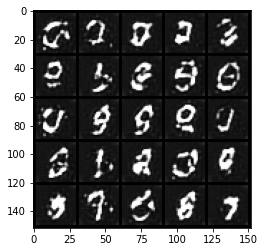

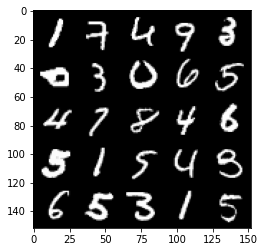

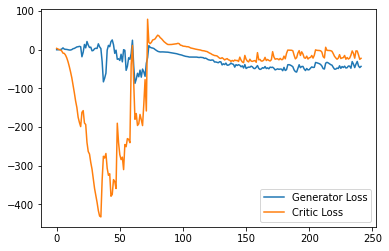

Step 4900: Generator loss: -45.41862869262695, critic loss: -24.485820324420928


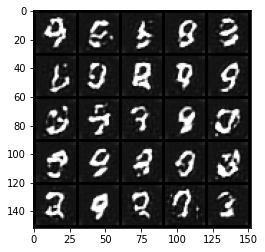

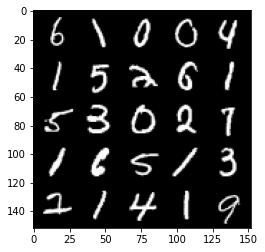

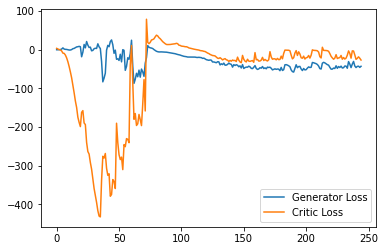

Step 4950: Generator loss: -42.22569705963135, critic loss: -22.591904953956604


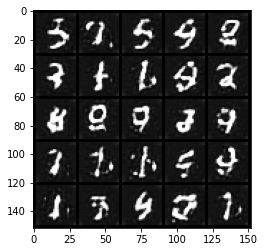

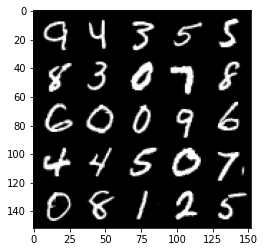

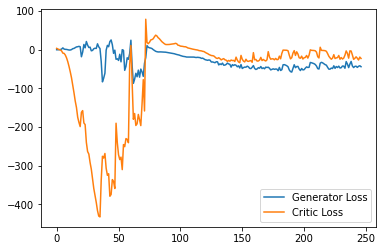

Step 5000: Generator loss: -39.32455200195312, critic loss: -2.358665819644927


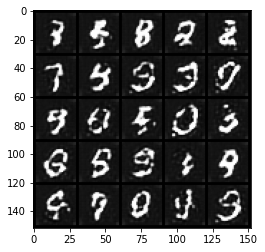

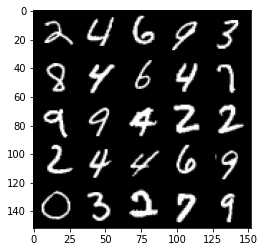

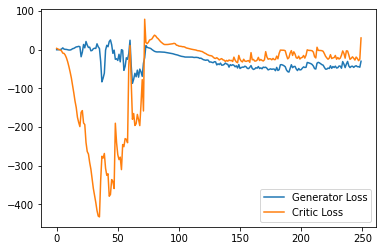

Step 5050: Generator loss: -29.338479537963867, critic loss: -1.8730488200187692


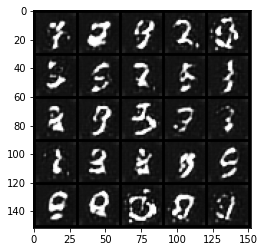

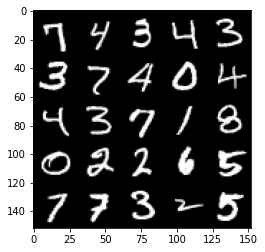

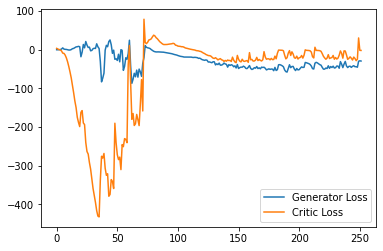

Step 5100: Generator loss: -31.61591037750244, critic loss: -2.031741458415985


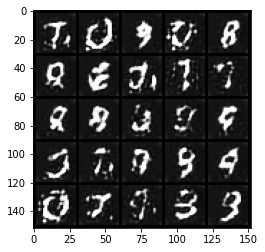

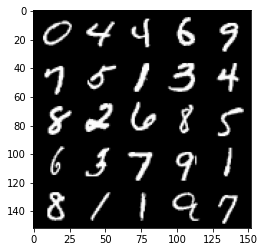

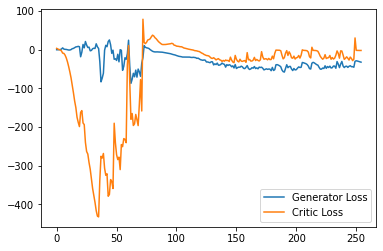

Step 5150: Generator loss: -33.472266082763674, critic loss: -2.189892630577087


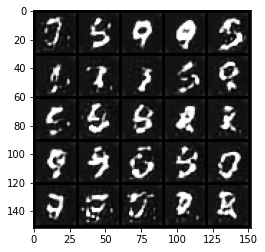

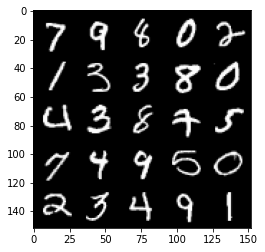

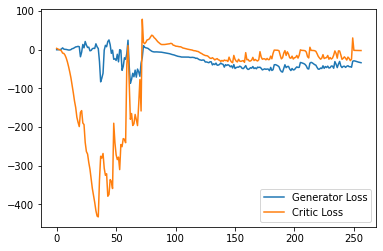

Step 5200: Generator loss: -34.601256408691405, critic loss: -2.4171453008651733


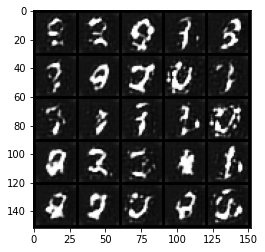

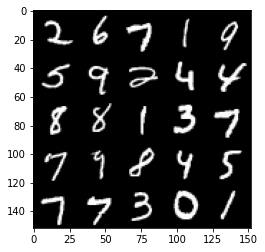

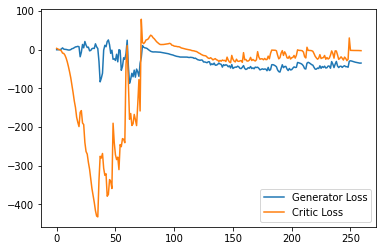

Step 5250: Generator loss: -34.58616859436035, critic loss: -2.6777276759147646


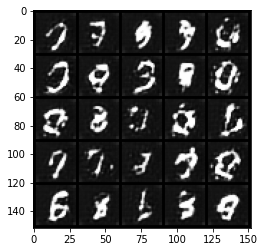

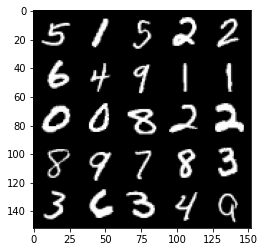

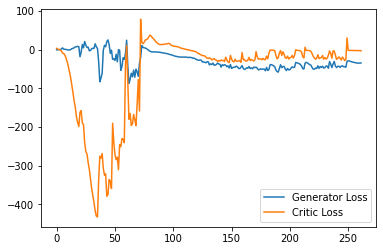

Step 5300: Generator loss: -34.866715850830076, critic loss: -2.9262905564308164


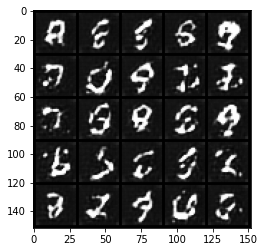

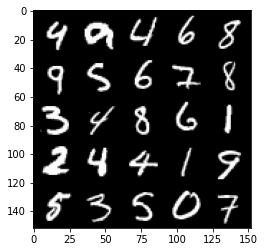

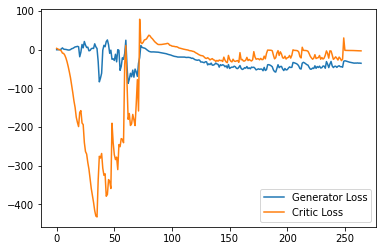

Step 5350: Generator loss: -35.73493705749512, critic loss: -3.080899497509003


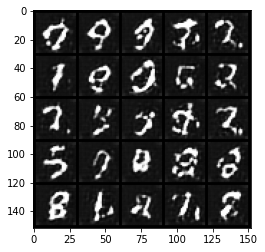

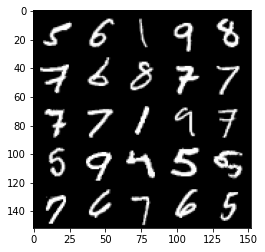

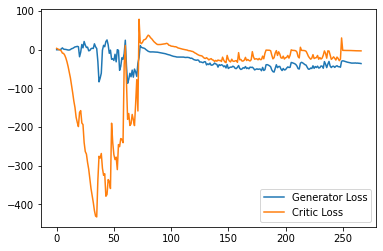

Step 5400: Generator loss: -36.687453765869144, critic loss: -2.683209436893463


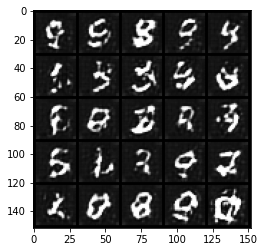

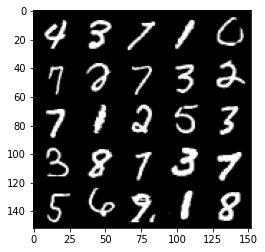

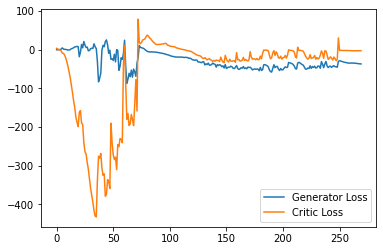

Step 5450: Generator loss: -36.18111488342285, critic loss: -3.221499477386475


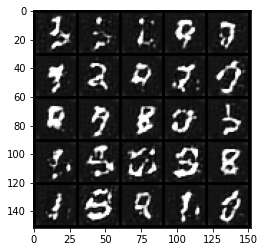

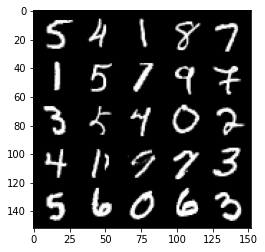

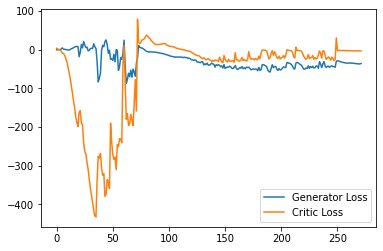

Step 5500: Generator loss: -36.91762130737305, critic loss: -4.428363867759705


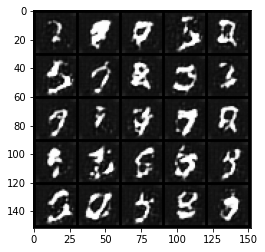

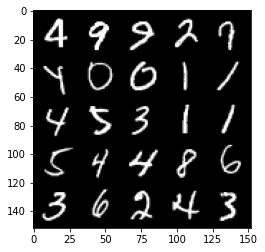

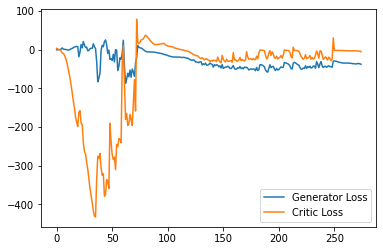

Step 5550: Generator loss: -35.39547409057617, critic loss: -2.821042855739594


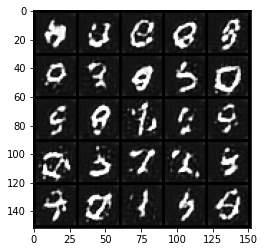

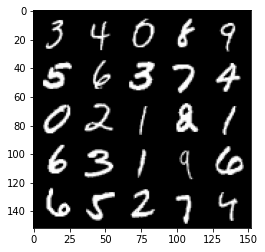

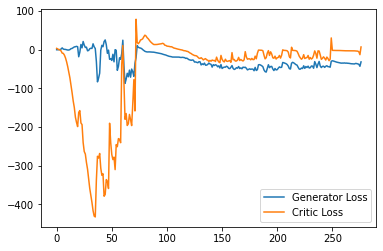

Step 5600: Generator loss: -31.381568336486815, critic loss: -3.009745130538942


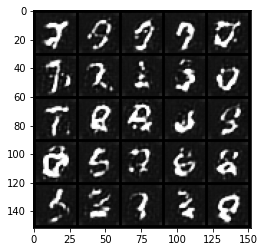

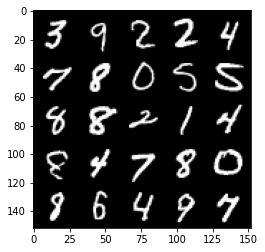

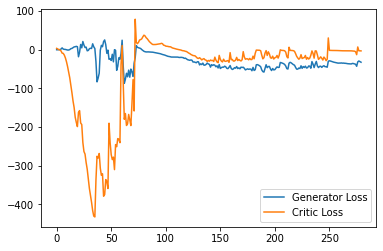

Step 5650: Generator loss: -34.086676330566405, critic loss: -4.318476991653443


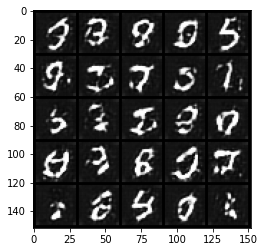

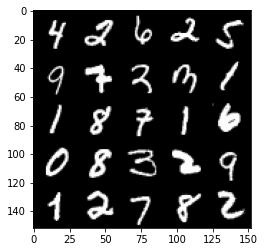

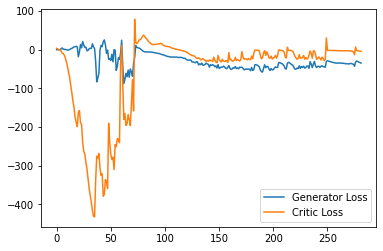

Step 5700: Generator loss: -40.69673835754394, critic loss: -14.862743832588194


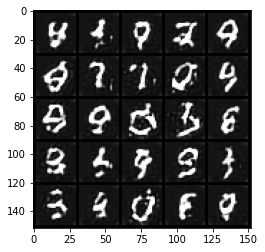

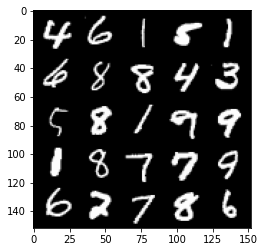

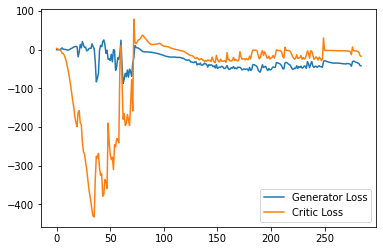

Step 5750: Generator loss: -32.3998091506958, critic loss: -8.55686734867096


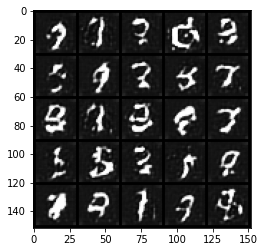

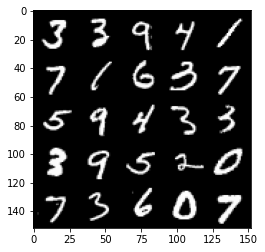

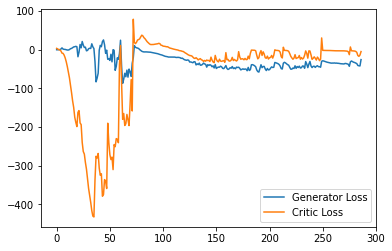

Step 5800: Generator loss: -38.323207244873046, critic loss: -15.56733595275879


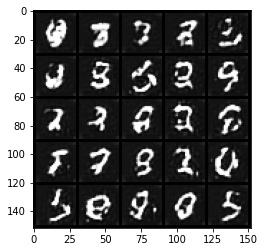

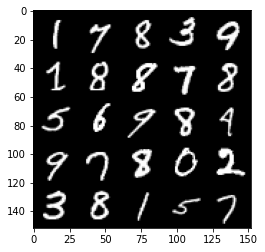

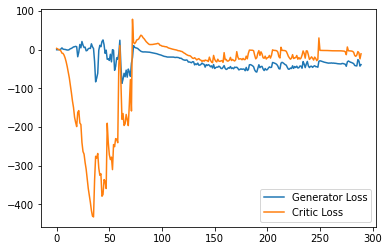

Step 5850: Generator loss: -26.367897987365723, critic loss: -5.777911243438722


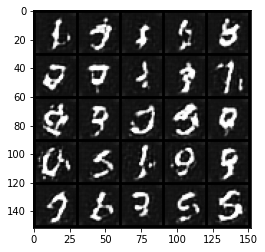

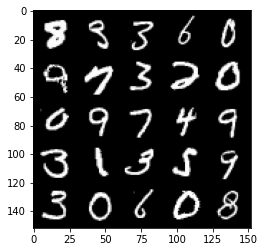

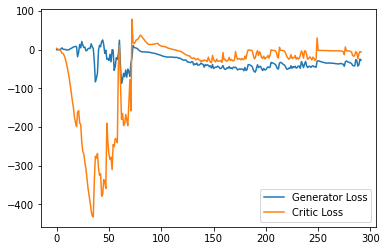

Step 5900: Generator loss: -39.72520244598389, critic loss: -21.02517951345444


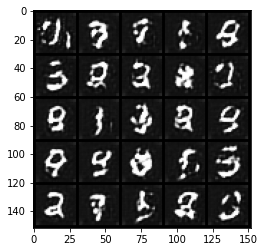

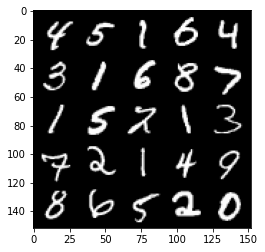

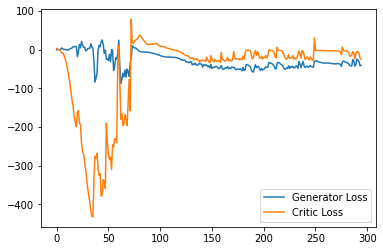

Step 5950: Generator loss: -27.14628608703613, critic loss: -1.3176221880912766


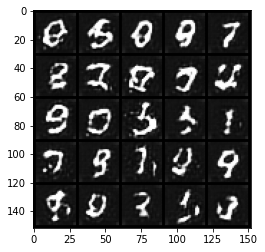

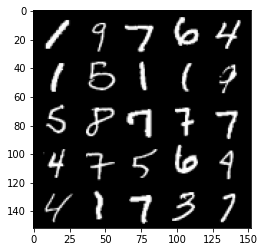

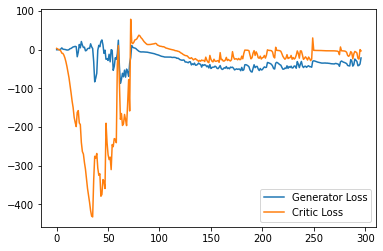

Step 6000: Generator loss: -23.81589168548584, critic loss: -3.0853191795349115


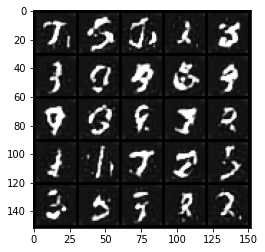

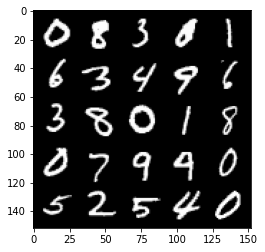

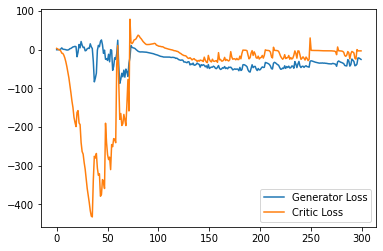

Step 6050: Generator loss: -27.250068435668947, critic loss: -3.268733170986177


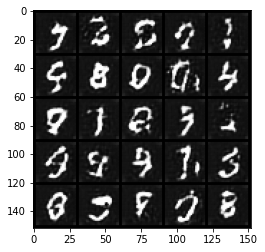

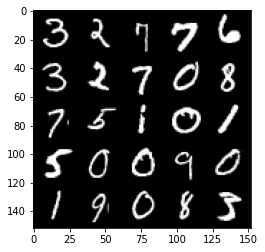

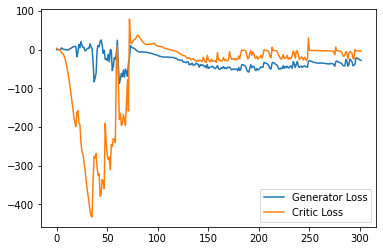

Step 6100: Generator loss: -28.65363872528076, critic loss: -3.443610622406006


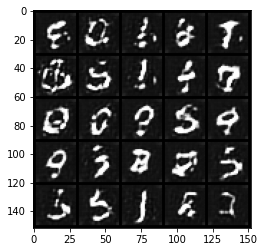

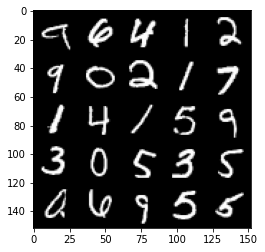

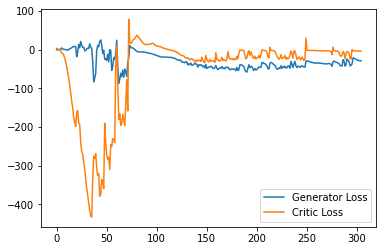

Step 6150: Generator loss: -29.04267105102539, critic loss: -3.6642834615707387


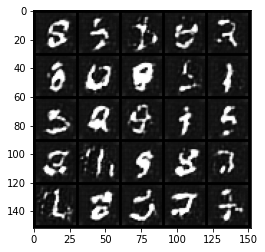

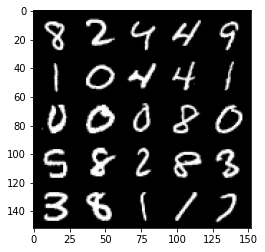

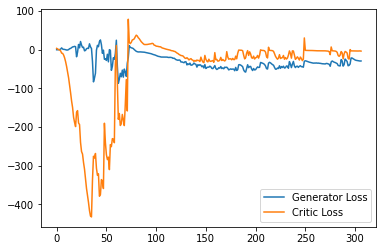

Step 6200: Generator loss: -34.58951049804688, critic loss: -11.589706684589387


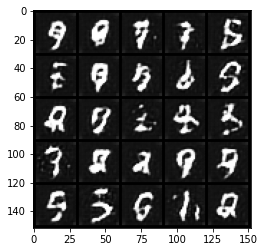

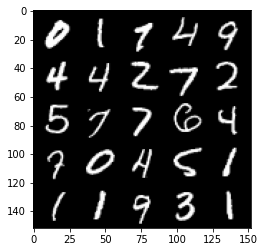

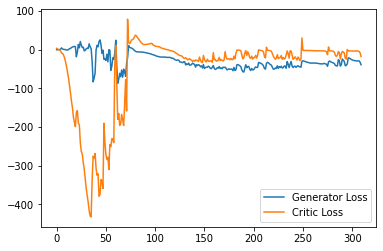

Step 6250: Generator loss: -33.86226692199707, critic loss: -7.723159666061403


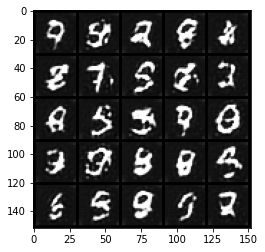

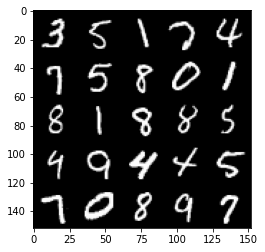

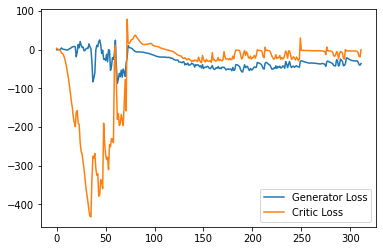

Step 6300: Generator loss: -22.185585975646973, critic loss: -3.0719247074127196


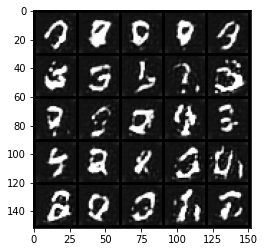

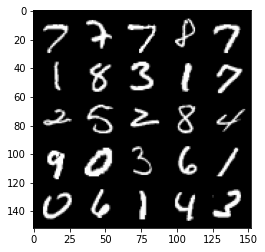

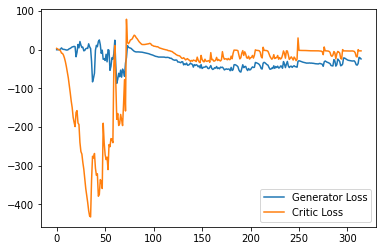

Step 6350: Generator loss: -27.112827835083007, critic loss: -3.3015327978134157


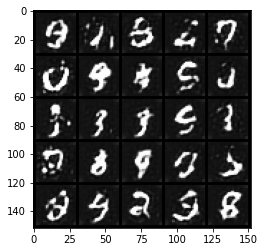

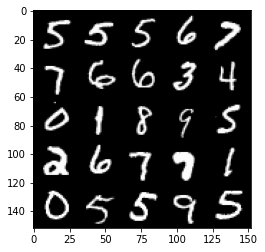

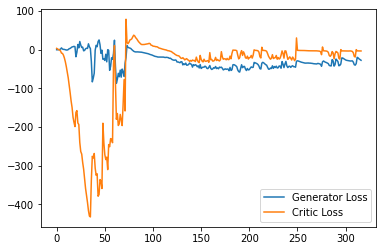

Step 6400: Generator loss: -29.722676849365236, critic loss: -4.056944953918458


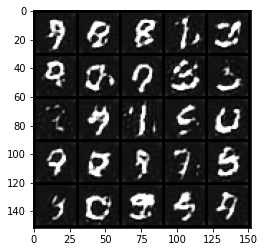

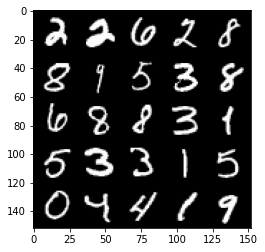

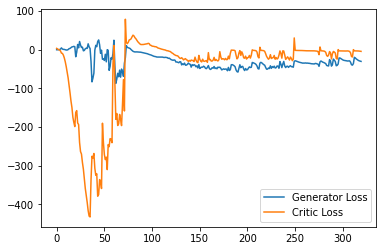

Step 6450: Generator loss: -37.850108528137206, critic loss: -18.18870704746247


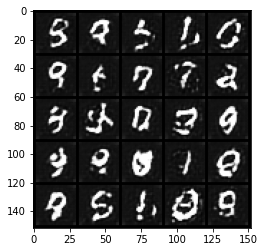

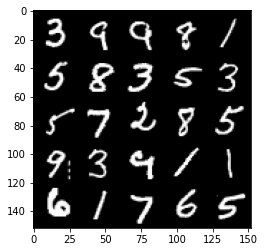

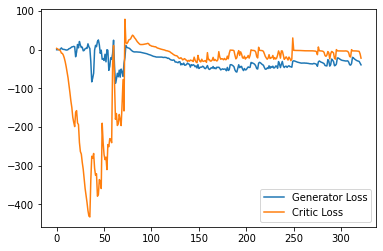

Step 6500: Generator loss: -32.35341289520264, critic loss: -21.51008693504334


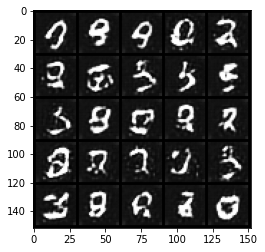

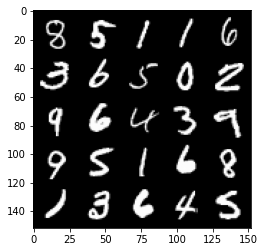

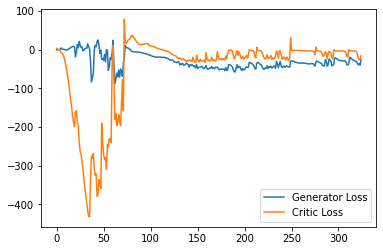

Step 6550: Generator loss: -36.06303050994873, critic loss: -25.50232333183289


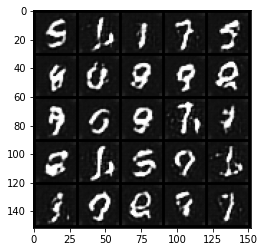

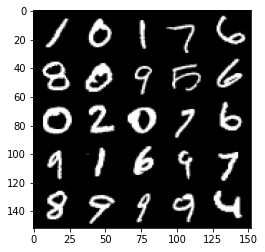

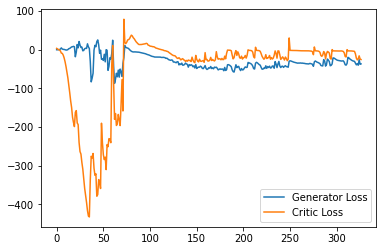

Step 6600: Generator loss: -20.830744514465334, critic loss: 5.586088155269623


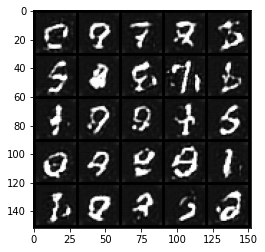

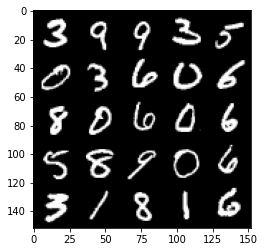

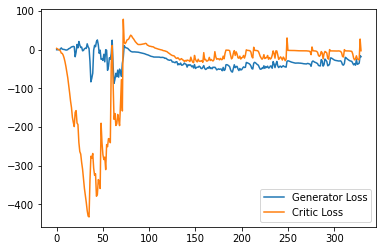

Step 6650: Generator loss: -20.2287686920166, critic loss: -2.6681720824241633


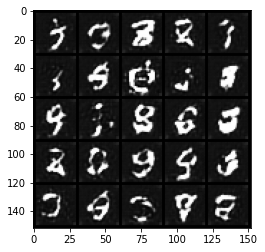

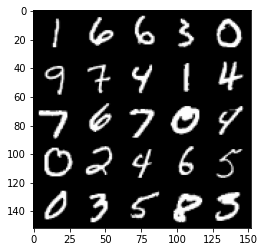

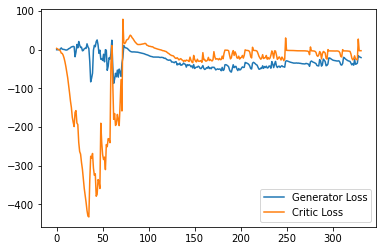

Step 6700: Generator loss: -22.513890228271485, critic loss: -2.855453854084015


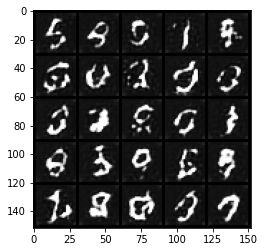

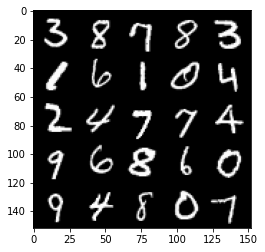

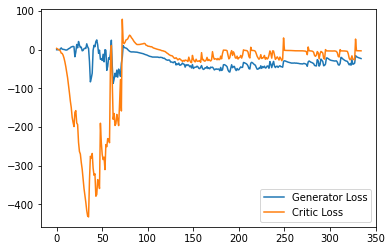

Step 6750: Generator loss: -24.540946159362793, critic loss: -3.1079494609832765


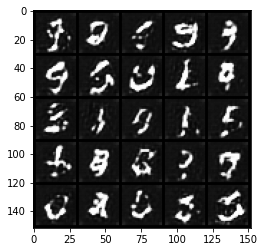

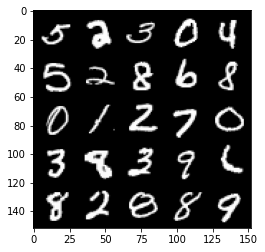

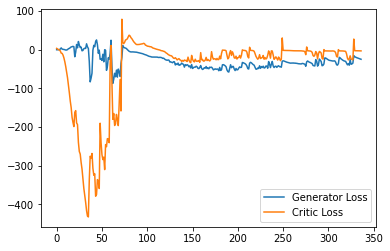

Step 6800: Generator loss: -25.065782051086426, critic loss: -3.299428188323975


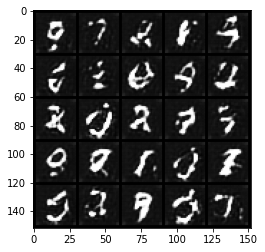

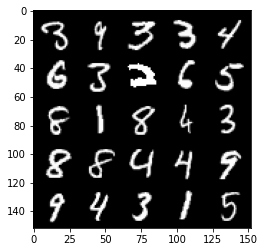

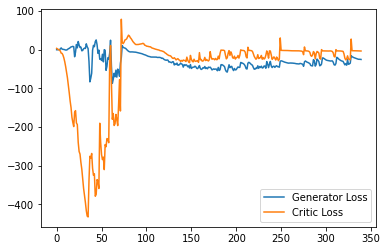

Step 6850: Generator loss: -25.575053634643556, critic loss: -3.3883661012649533


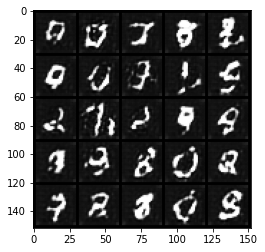

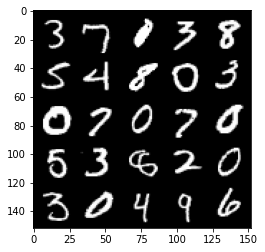

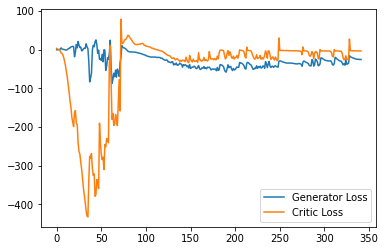

Step 6900: Generator loss: -25.426701736450195, critic loss: -3.852471655845642


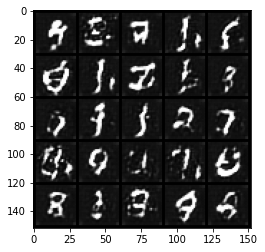

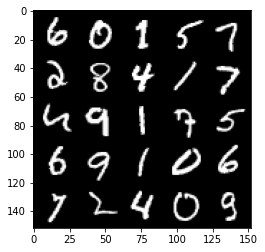

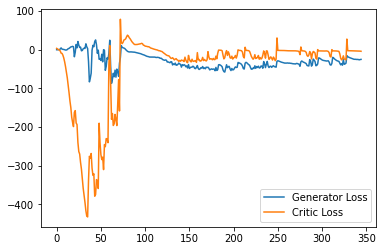

Step 6950: Generator loss: -29.42172622680664, critic loss: -8.410800994873046


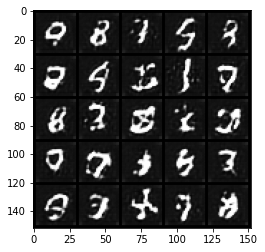

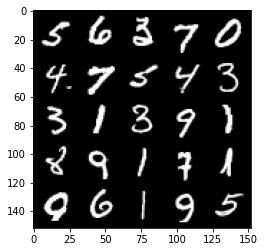

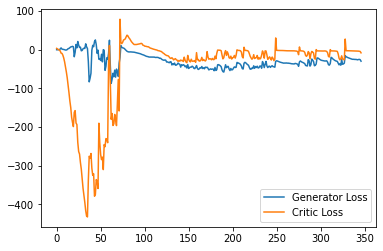

Step 7000: Generator loss: -35.01832815170288, critic loss: -19.976084411621095


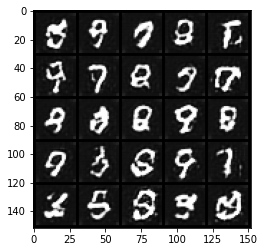

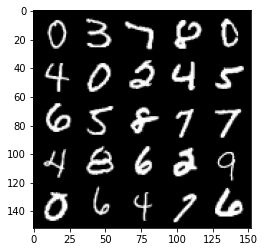

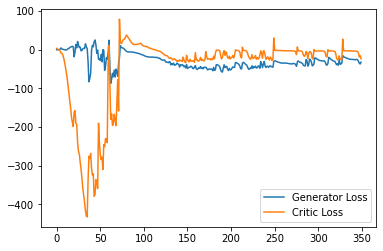

Step 7050: Generator loss: -34.26992176055908, critic loss: -22.070636859893792


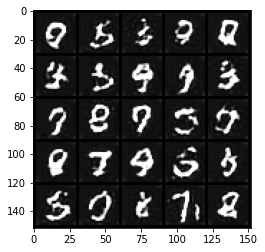

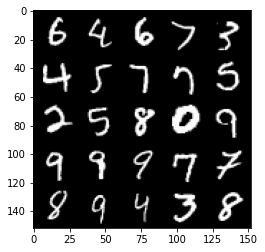

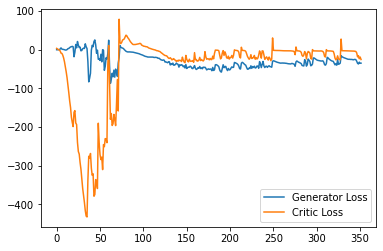

Step 7100: Generator loss: -26.588347754478455, critic loss: -15.335807471275324


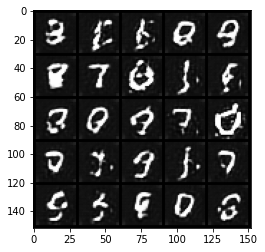

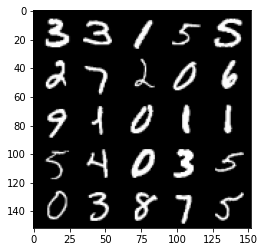

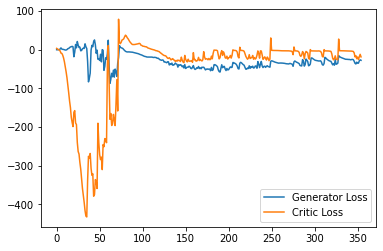

Step 7150: Generator loss: -31.78182647705078, critic loss: -27.21544988155365


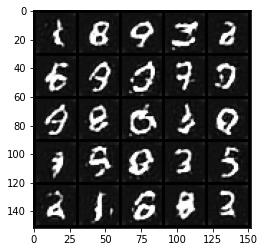

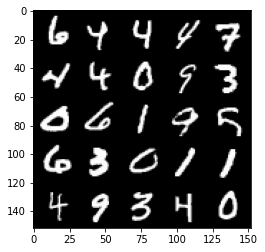

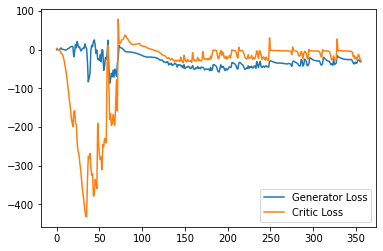

Step 7200: Generator loss: -22.45356216430664, critic loss: -7.9681581296920765


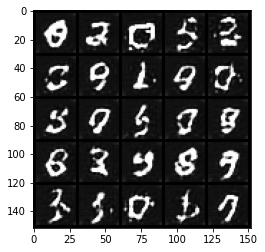

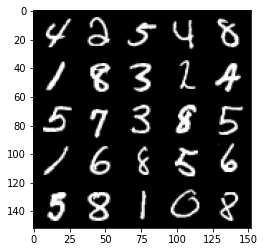

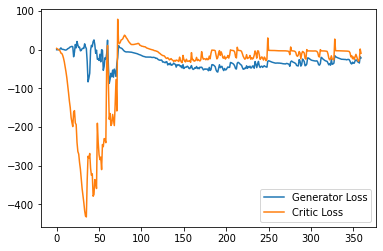

Step 7250: Generator loss: -31.98126733779907, critic loss: -23.10859232616425


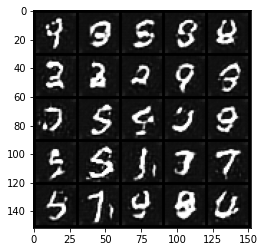

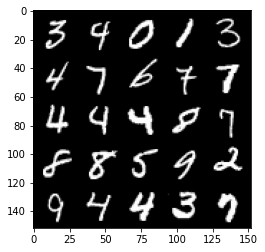

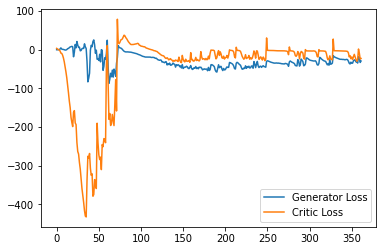

Step 7300: Generator loss: -28.15467409133911, critic loss: -21.47648447418213


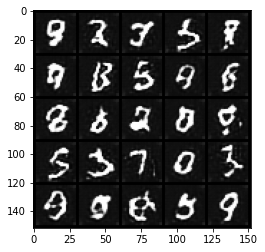

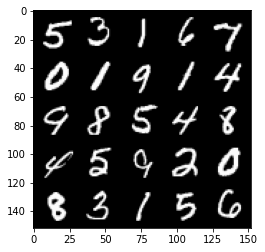

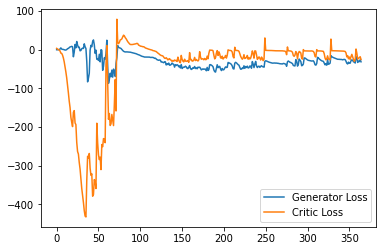

Step 7350: Generator loss: -25.550142848491667, critic loss: -22.891678312301632


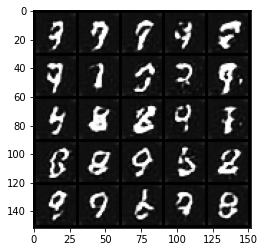

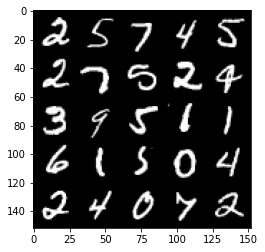

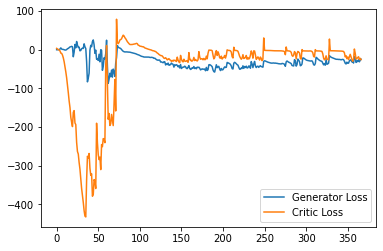

Step 7400: Generator loss: -21.166872577667235, critic loss: -7.828521154880525


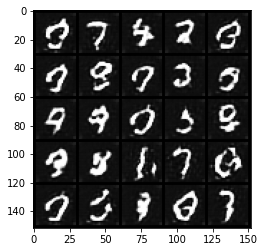

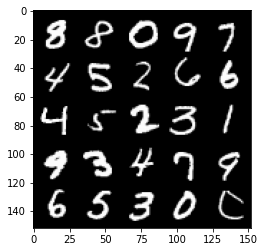

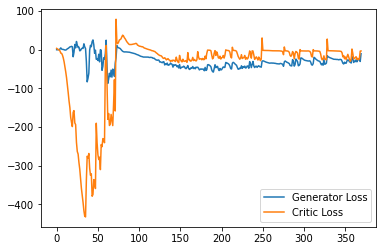

Step 7450: Generator loss: -11.14622901916504, critic loss: -3.4412617921829223


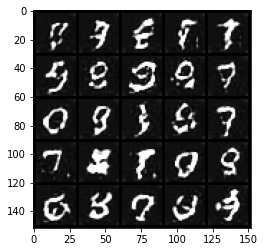

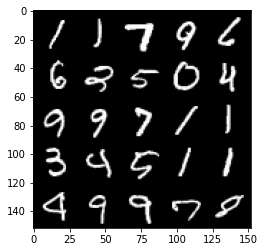

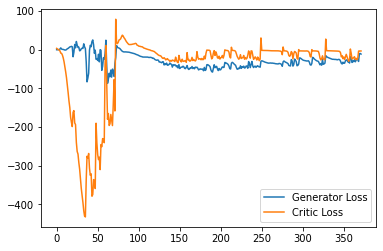

Step 7500: Generator loss: -15.96349401473999, critic loss: -3.9511680727005


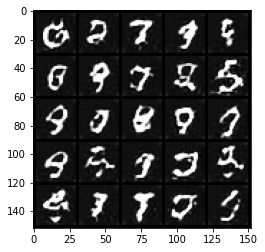

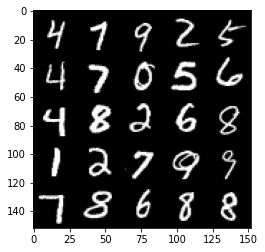

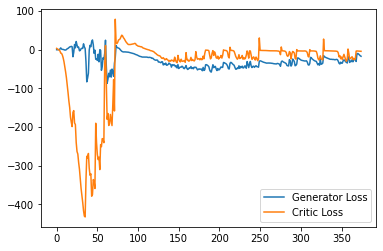

Step 7550: Generator loss: -19.77896520614624, critic loss: -8.293875111579895


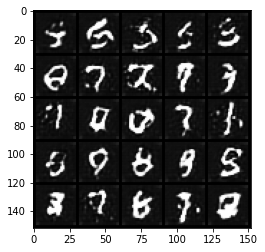

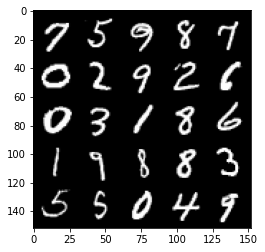

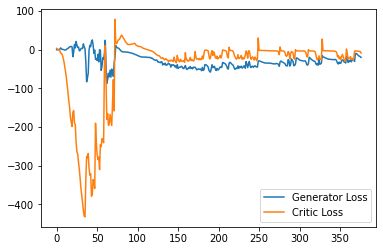

Step 7600: Generator loss: -25.675937461853028, critic loss: -10.975429877758032


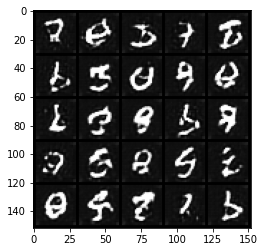

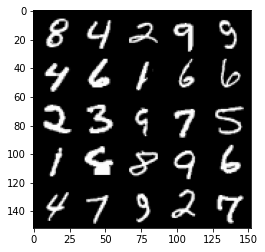

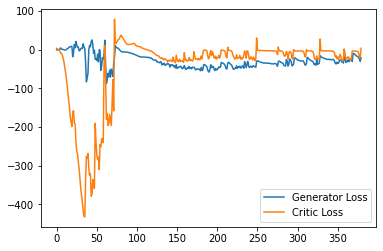

Step 7650: Generator loss: -11.954194412231445, critic loss: -3.1082852048873906


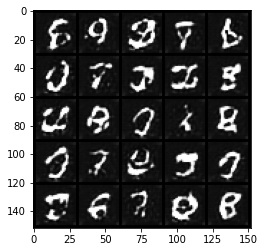

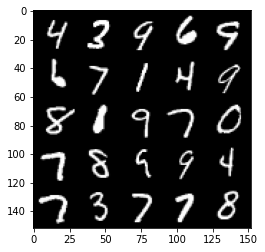

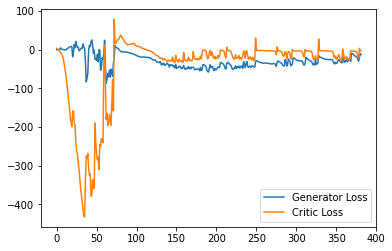

Step 7700: Generator loss: -15.352535438537597, critic loss: -3.423738924980164


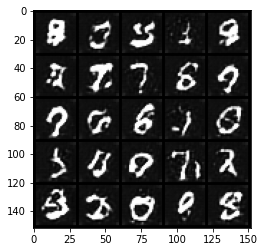

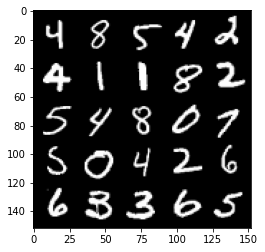

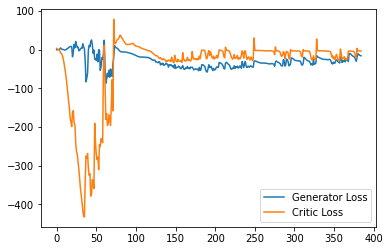

Step 7750: Generator loss: -17.360333919525146, critic loss: -4.855101130485535


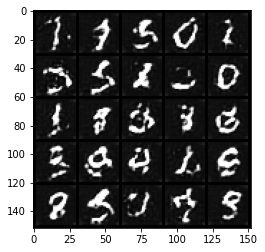

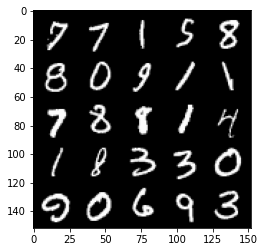

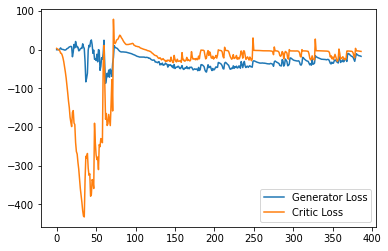

Step 7800: Generator loss: -24.218735892772674, critic loss: -18.224018002033233


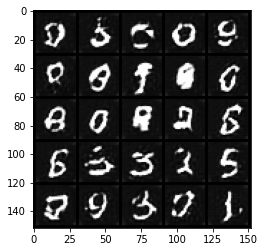

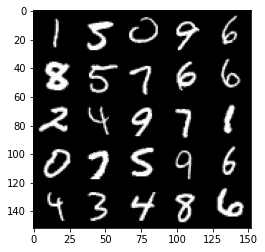

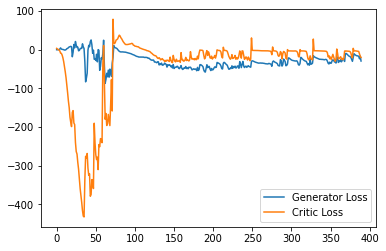

Step 7850: Generator loss: -13.895592308044433, critic loss: -2.5067985653877263


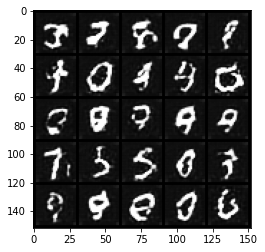

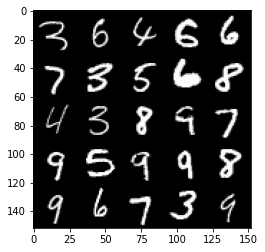

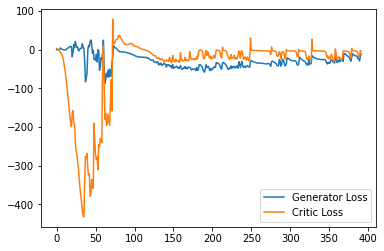

Step 7900: Generator loss: -13.40488868713379, critic loss: -3.5684184255599978


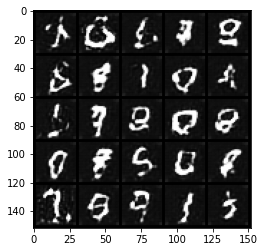

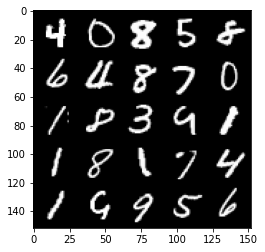

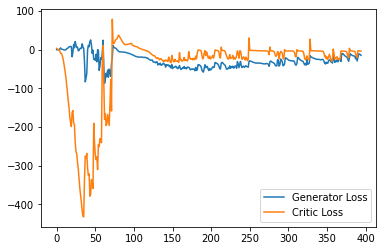

Step 7950: Generator loss: -20.210553131103516, critic loss: -9.320928738594056


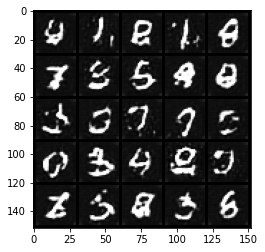

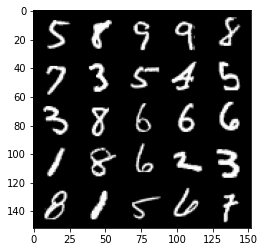

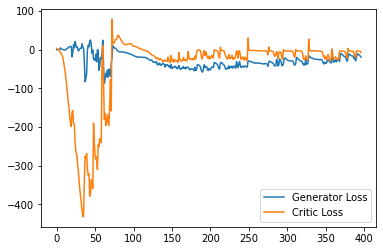

Step 8000: Generator loss: -27.397489805221557, critic loss: -18.94049476623535


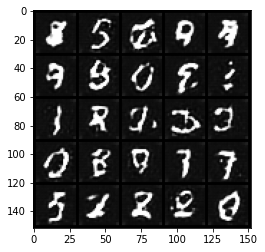

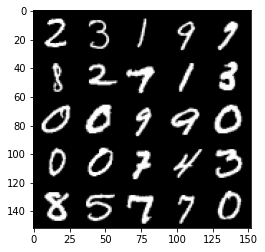

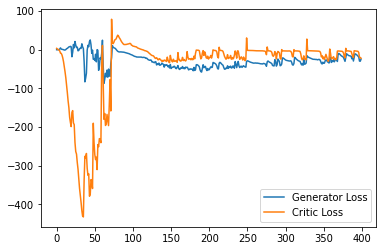

Step 8050: Generator loss: -20.473489360809324, critic loss: -14.959775102615357


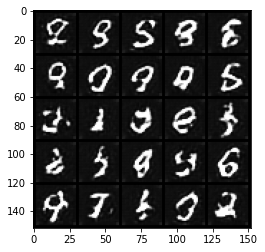

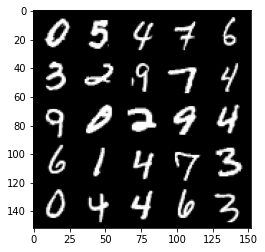

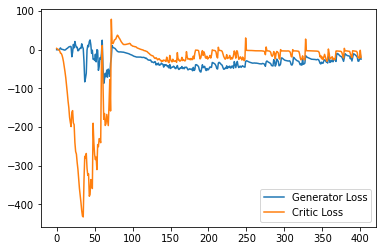

Step 8100: Generator loss: -20.98838948726654, critic loss: -21.658265050172805


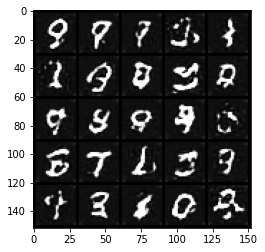

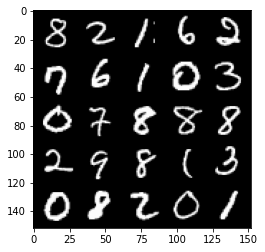

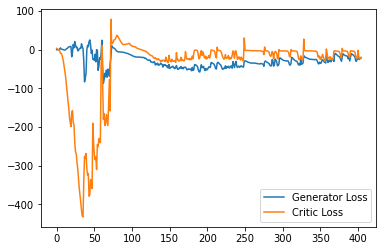

Step 8150: Generator loss: -17.161076143980026, critic loss: -12.569488811492924


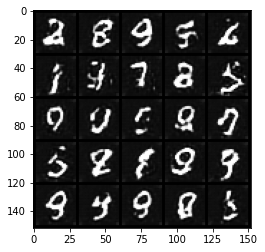

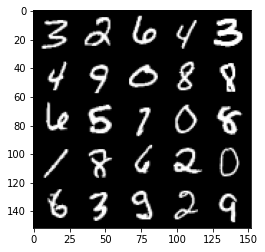

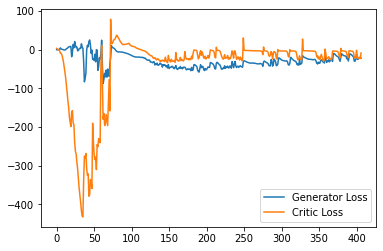

Step 8200: Generator loss: -4.772293787002564, critic loss: -3.1932242727279663


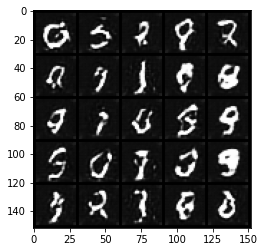

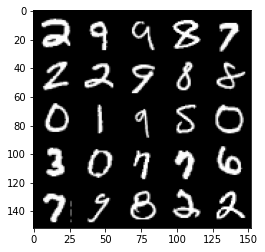

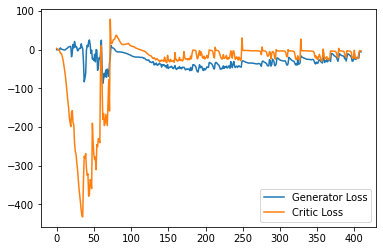

Step 8250: Generator loss: -7.469092893600464, critic loss: -3.662297008514405


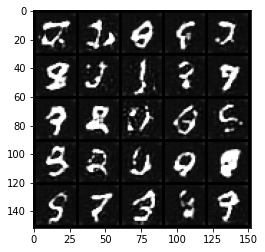

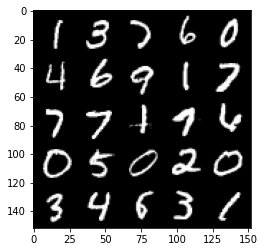

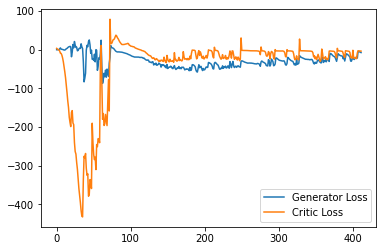

Step 8300: Generator loss: -16.318594455718994, critic loss: -13.3212469291687


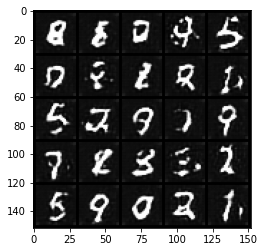

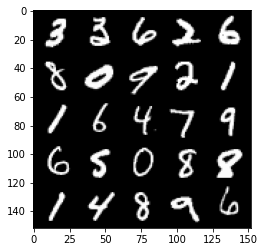

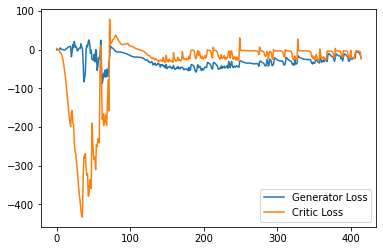

Step 8350: Generator loss: -18.044794640541078, critic loss: -12.276354588747024


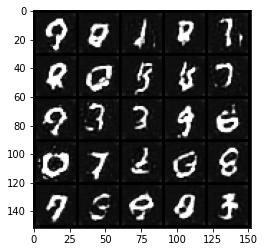

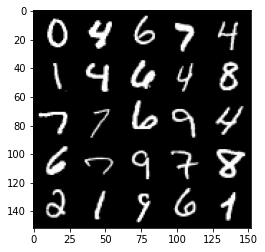

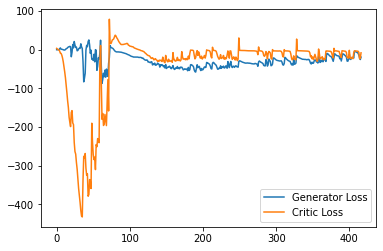

Step 8400: Generator loss: -4.228085045814514, critic loss: -3.905867470741273


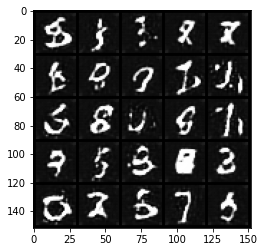

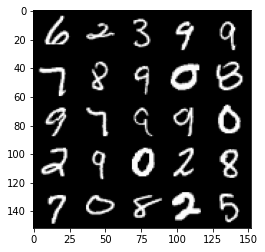

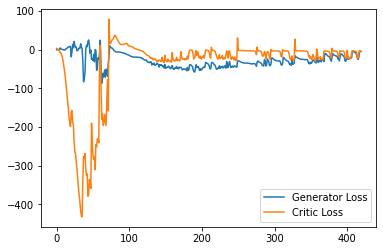

Step 8450: Generator loss: -18.537118349075318, critic loss: -16.210990652084355


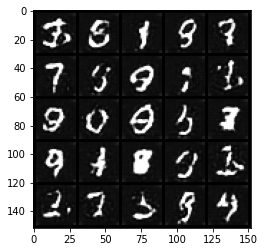

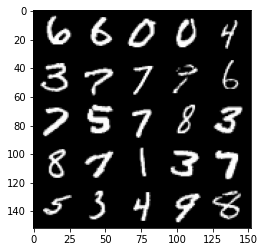

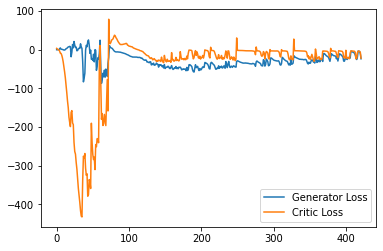

Step 8500: Generator loss: -16.737779099941253, critic loss: -19.645063704967495


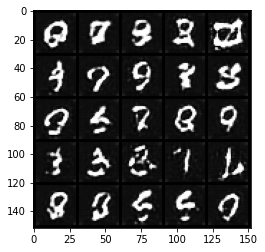

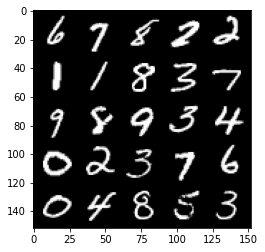

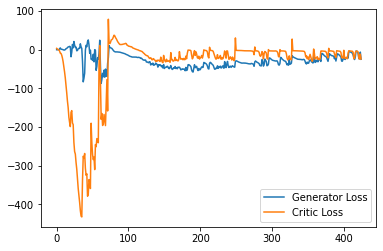

Step 8550: Generator loss: -18.1212096786499, critic loss: -21.576557743549348


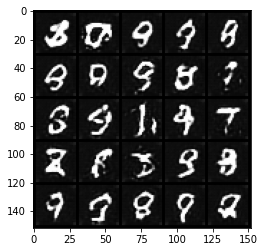

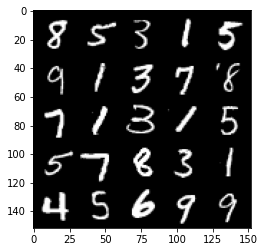

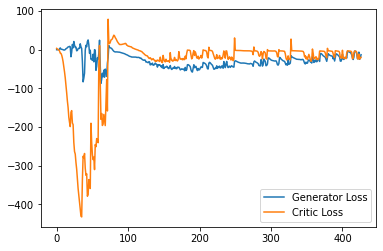

Step 8600: Generator loss: -12.964931174516678, critic loss: -20.38383856391906


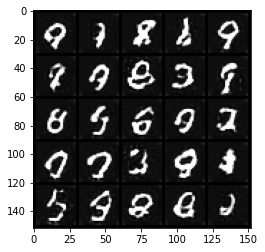

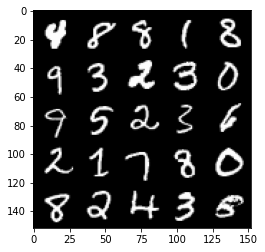

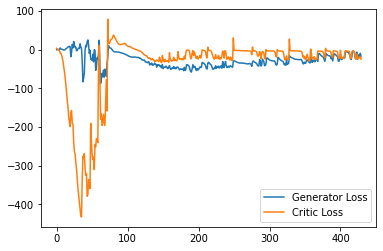

Step 8650: Generator loss: -4.946841365545988, critic loss: -1.3928261971473679


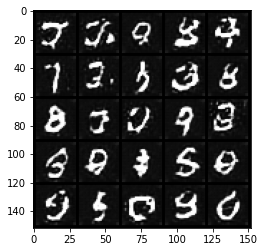

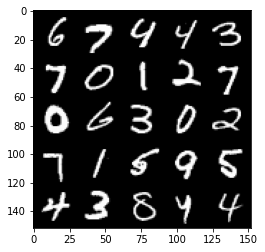

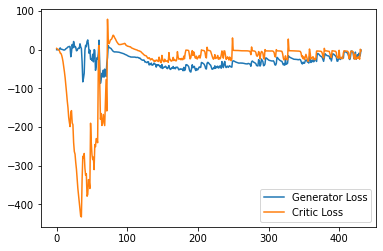

Step 8700: Generator loss: -1.4479001074284314, critic loss: -3.3938285369873045


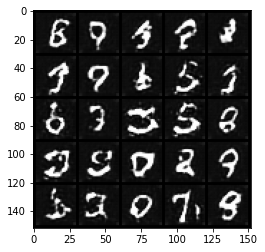

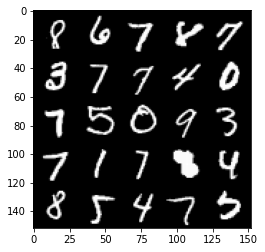

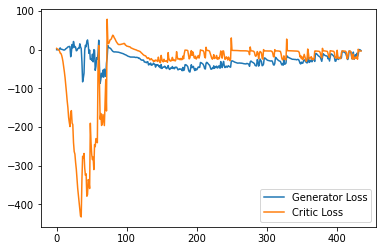

Step 8750: Generator loss: -5.597325859069824, critic loss: -3.895081569671632


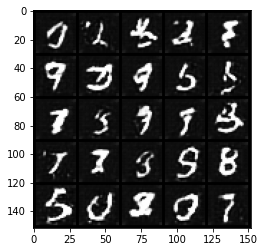

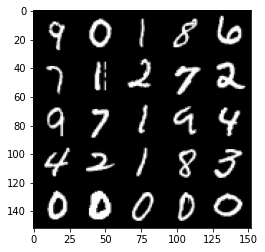

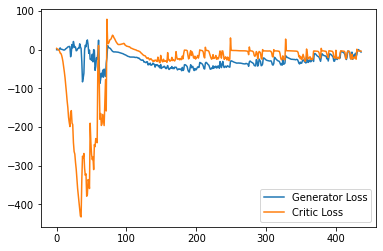

Step 8800: Generator loss: -12.101889727115632, critic loss: -10.630999260902401


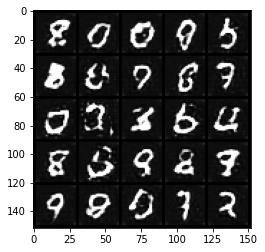

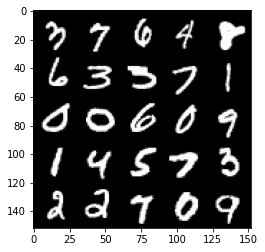

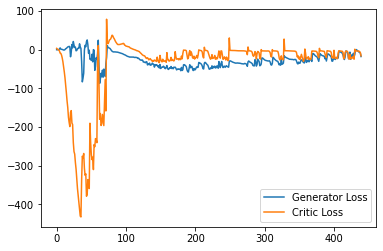

Step 8850: Generator loss: -16.090787887573242, critic loss: -19.83630750465393


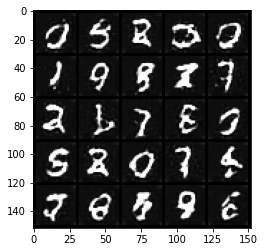

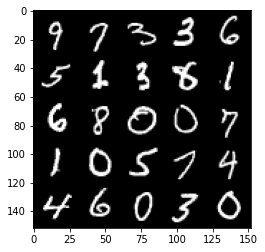

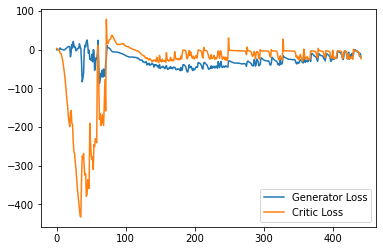

Step 8900: Generator loss: -7.656367837786674, critic loss: -15.908405834197998


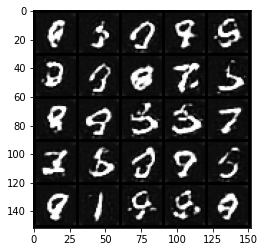

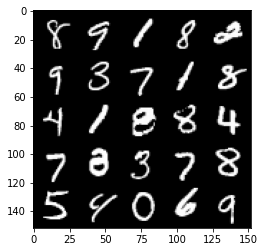

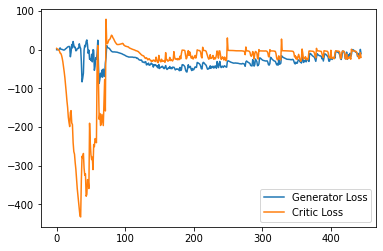

Step 8950: Generator loss: -16.848324896693228, critic loss: -24.57914893960952


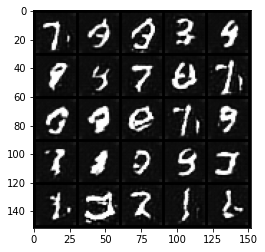

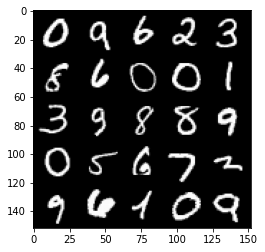

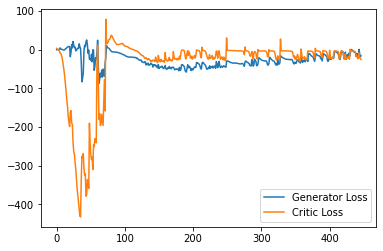

Step 9000: Generator loss: -14.638967831432819, critic loss: -18.41833109092713


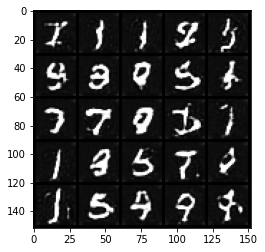

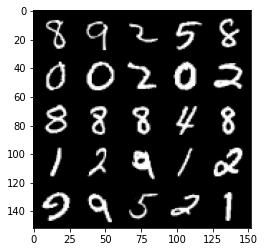

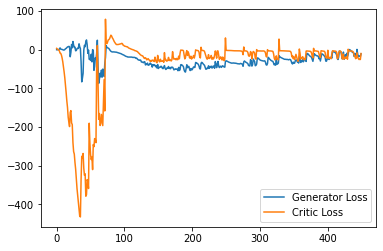

Step 9050: Generator loss: -9.378833546042442, critic loss: -15.921692929506298


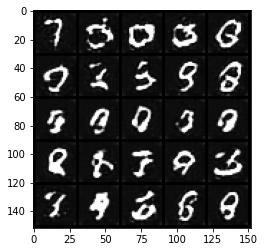

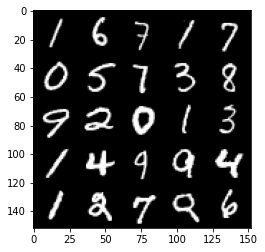

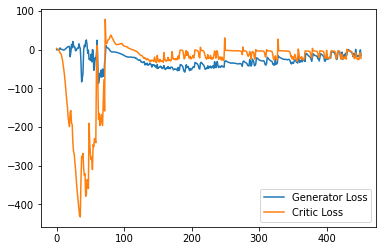

Step 9100: Generator loss: 0.366563748344779, critic loss: 8.513965341567996


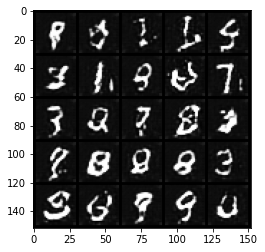

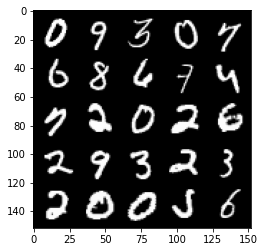

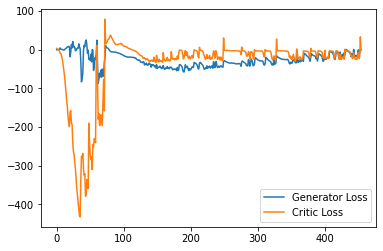

Step 9150: Generator loss: -0.2019136533886194, critic loss: -2.378832482814789


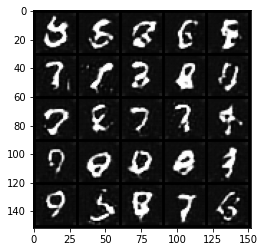

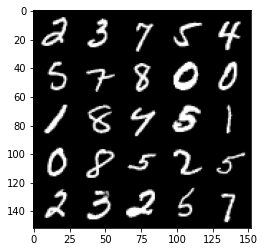

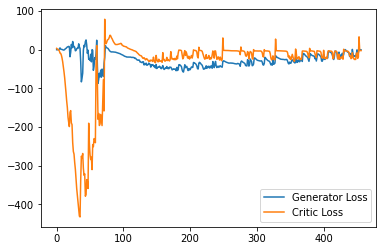

Step 9200: Generator loss: -0.632434680312872, critic loss: -2.490373326301575


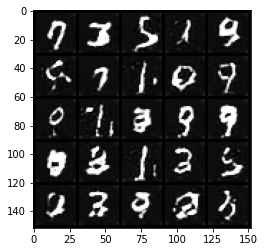

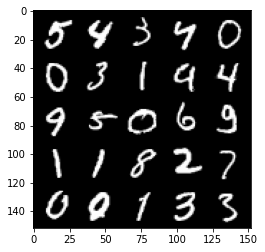

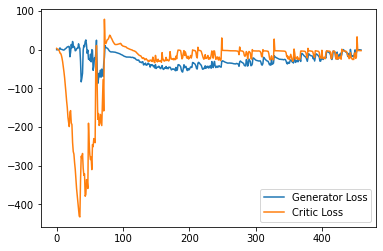

Step 9250: Generator loss: -1.4645193123817444, critic loss: -2.6621878890991217


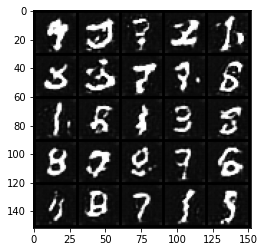

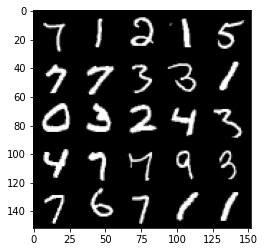

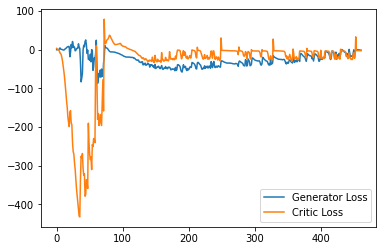

Step 9300: Generator loss: -2.0888977789878846, critic loss: -2.823930906295776


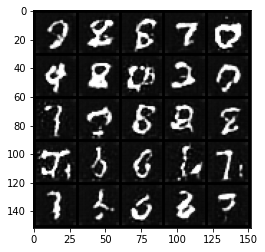

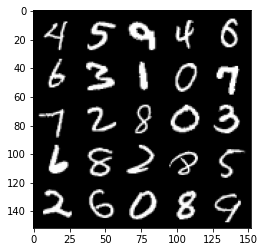

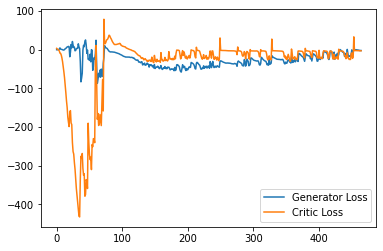

Step 9350: Generator loss: -2.586333603858948, critic loss: -3.0129888839721675


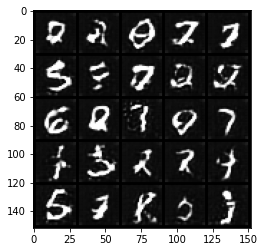

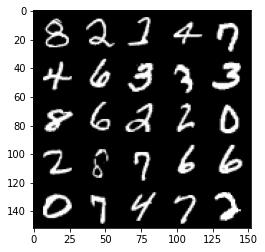

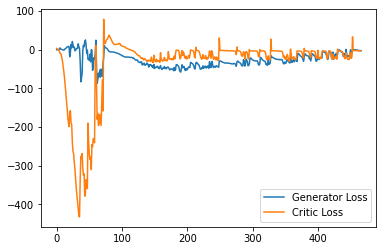

Step 9400: Generator loss: -3.6358597898483276, critic loss: -3.171848205566407


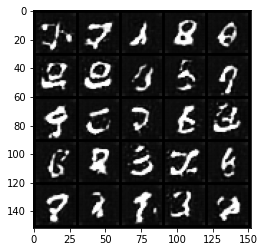

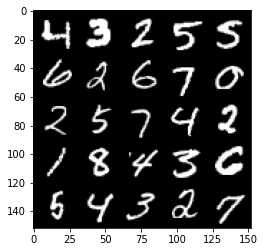

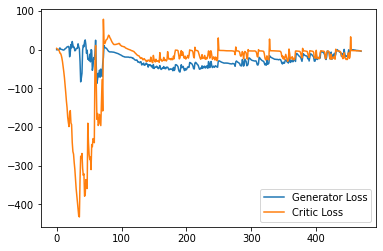

Step 9450: Generator loss: -4.361106505393982, critic loss: -3.222491745948791


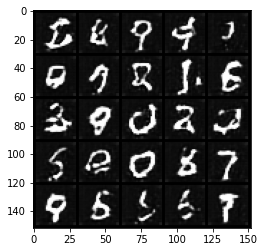

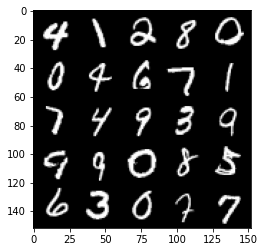

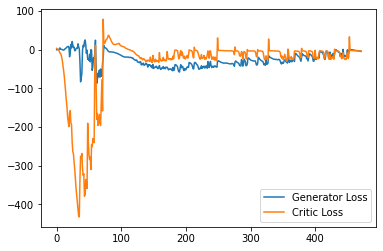

Step 9500: Generator loss: -4.600658049583435, critic loss: -3.5875835533142113


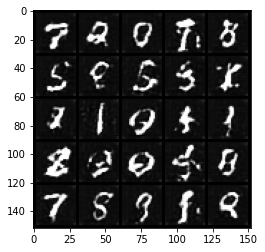

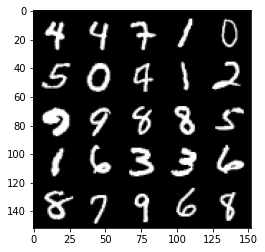

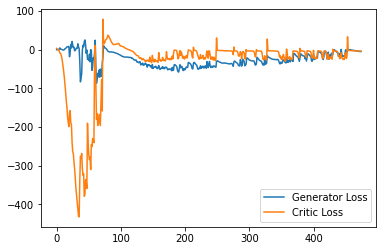

Step 9550: Generator loss: -4.991367774158716, critic loss: -0.014392410755158238


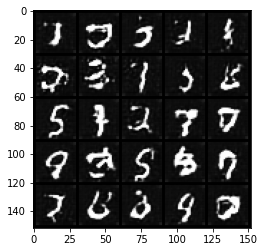

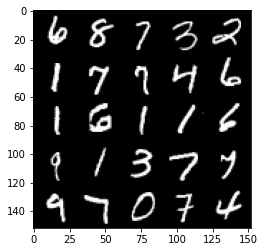

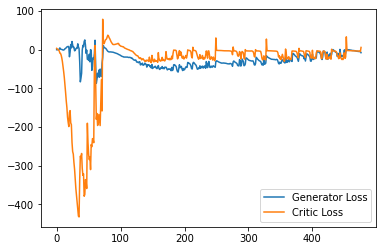

Step 9600: Generator loss: -0.6998580701649189, critic loss: -2.5276922574043272


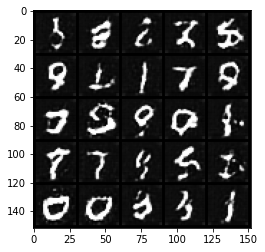

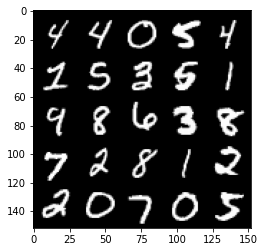

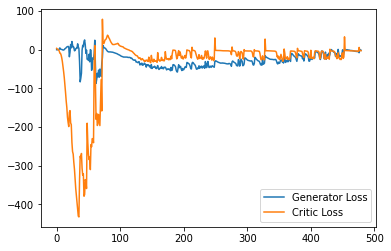

Step 9650: Generator loss: -2.8212246990203855, critic loss: -2.8731495103836058


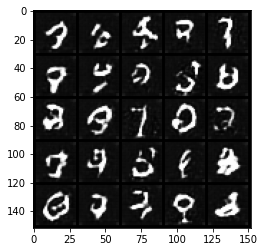

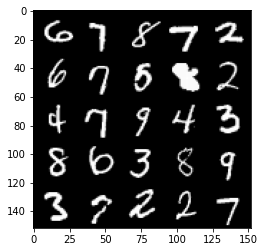

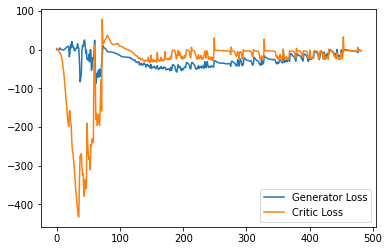

Step 9700: Generator loss: -3.6706977891921997, critic loss: -3.485249545097351


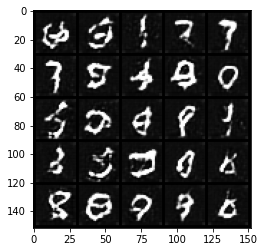

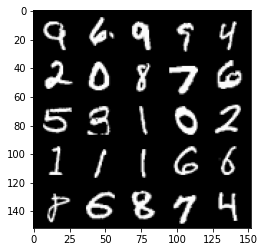

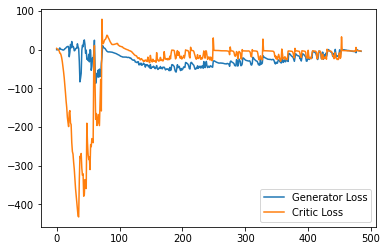

Step 9750: Generator loss: -14.505789773464203, critic loss: -16.38473346042633


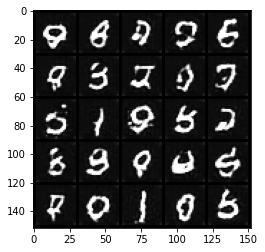

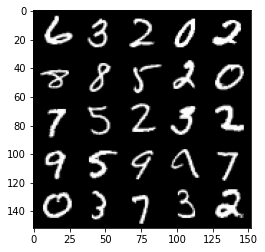

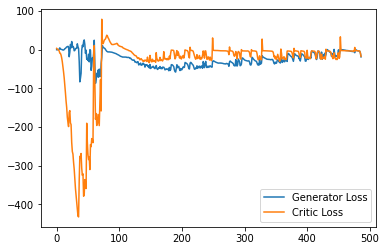

Step 9800: Generator loss: -1.5807552593946457, critic loss: 2.225171532154083


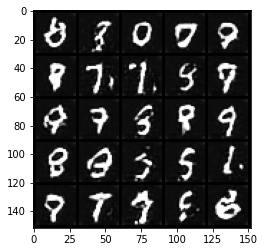

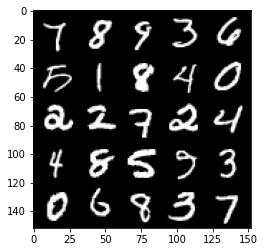

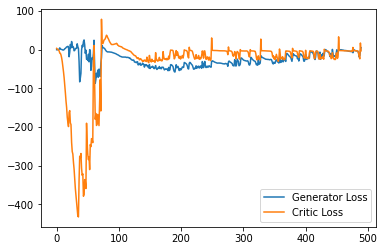

Step 9850: Generator loss: 3.208112394809723, critic loss: -3.023572947502136


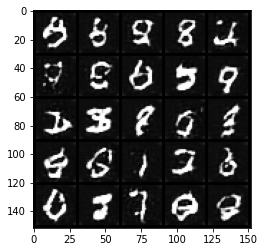

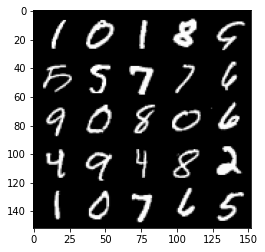

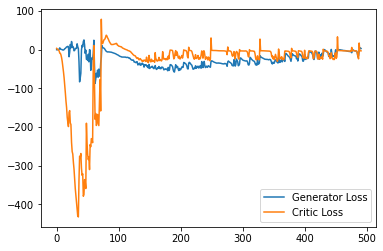

Step 9900: Generator loss: -1.0529998664557934, critic loss: -3.1260793581008914


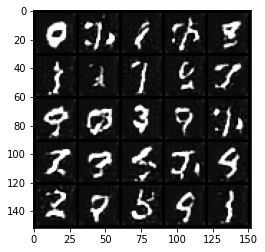

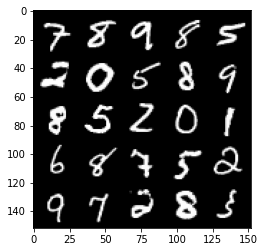

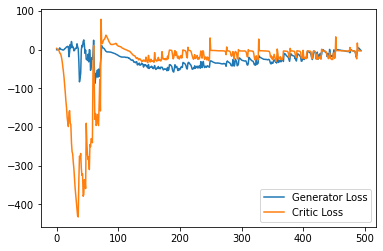

Step 9950: Generator loss: -1.5094155707955361, critic loss: -4.2454691410064695


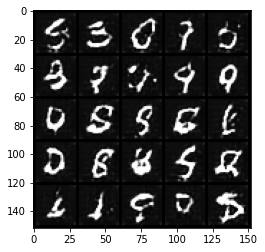

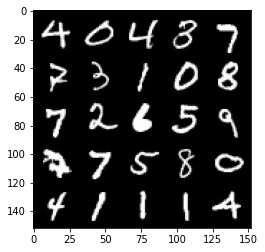

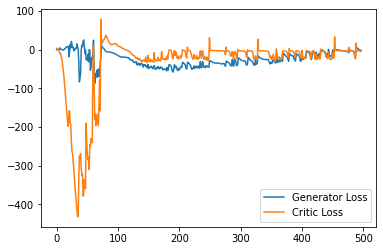

Step 10000: Generator loss: -4.965334337651729, critic loss: -7.423989301919937


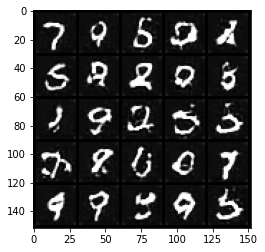

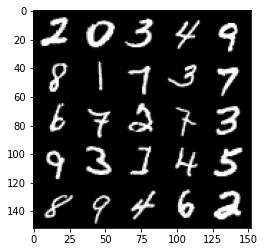

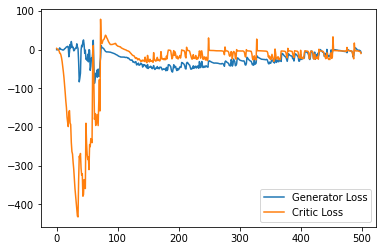

Step 10050: Generator loss: -10.134952738285065, critic loss: -17.4230667219162


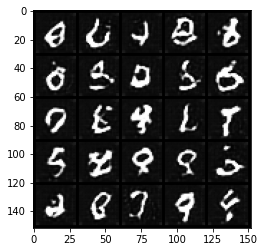

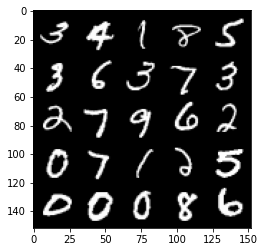

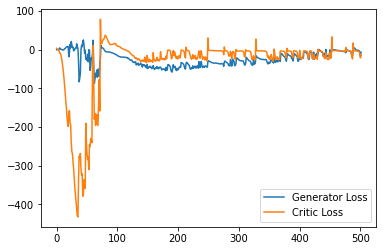

Step 10100: Generator loss: -9.40031265258789, critic loss: -19.987673885822293


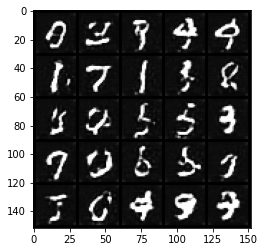

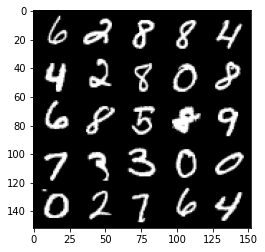

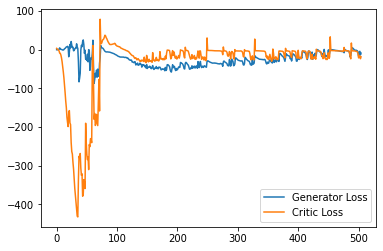

Step 10150: Generator loss: -5.69639920771122, critic loss: -18.37884988737106


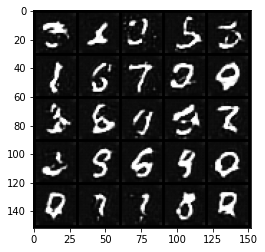

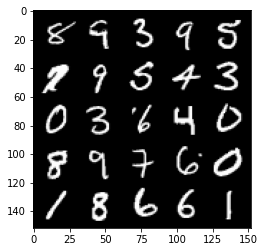

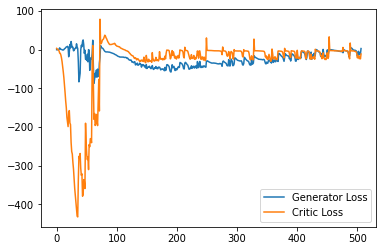

Step 10200: Generator loss: -6.553007488250732, critic loss: -15.005140382528298


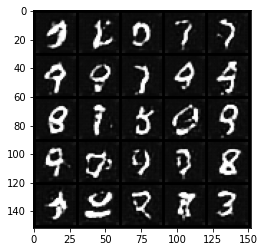

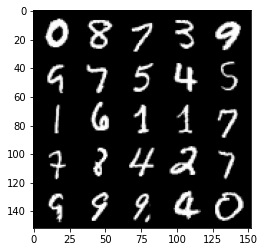

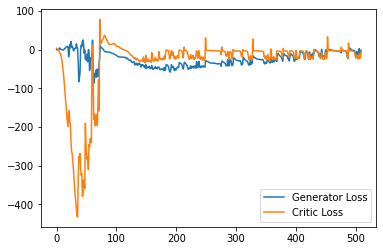

Step 10250: Generator loss: 2.65361970320344, critic loss: -5.958103922843933


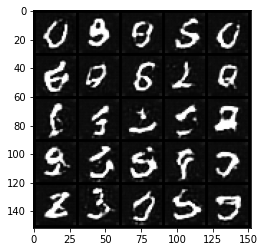

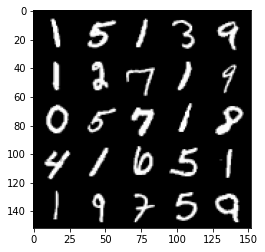

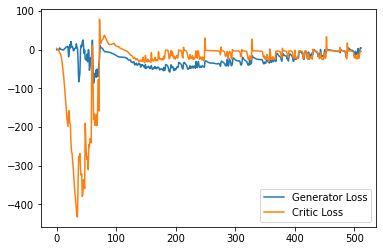

Step 10300: Generator loss: -5.5249033093452455, critic loss: -18.433552609443662


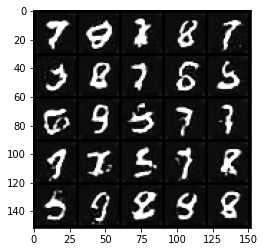

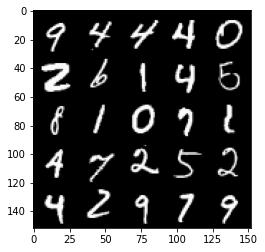

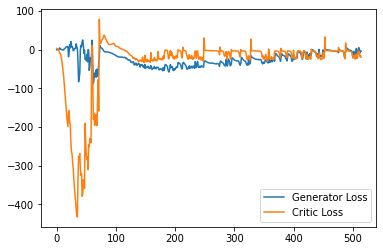

Step 10350: Generator loss: 3.2728555220365525, critic loss: 0.3527217097282416


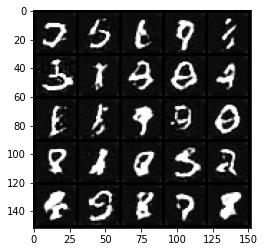

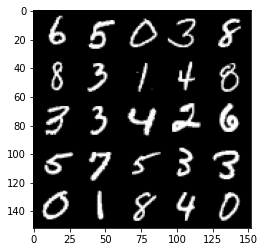

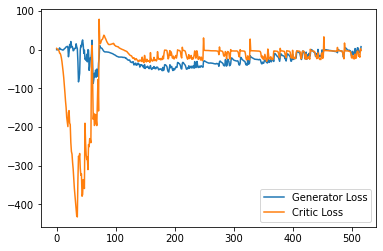

Step 10400: Generator loss: 7.058397808074951, critic loss: -3.817311916351317


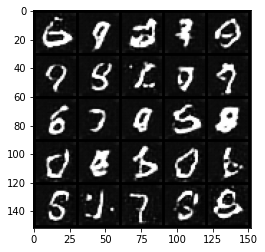

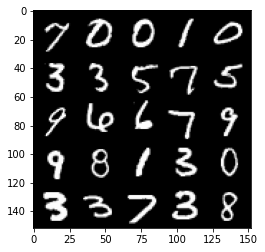

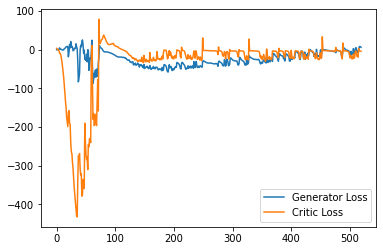

Step 10450: Generator loss: -0.7717583574354648, critic loss: -8.90465840625763


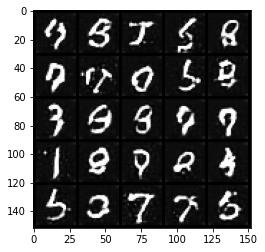

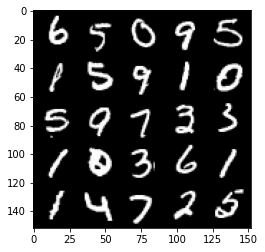

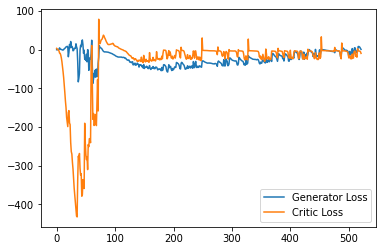

Step 10500: Generator loss: 1.8087068289518355, critic loss: -9.653604766368867


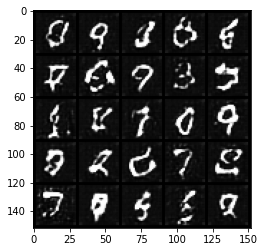

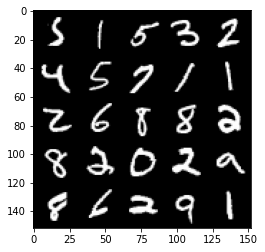

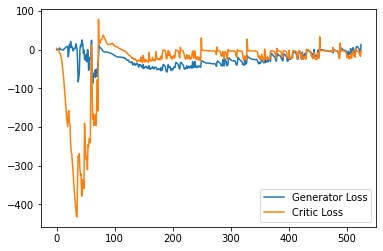

Step 10550: Generator loss: -3.340324494242668, critic loss: -8.702077420234684


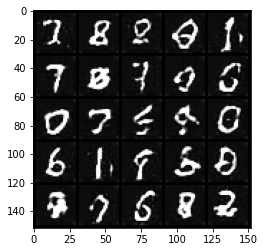

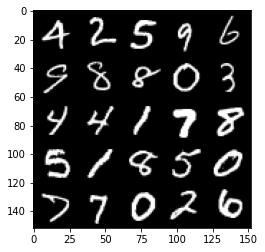

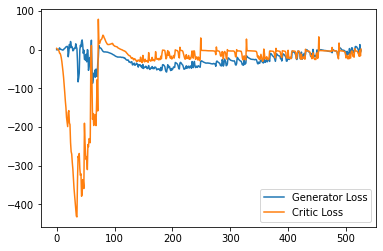

Step 10600: Generator loss: 3.4701057720184325, critic loss: -11.125499455213548


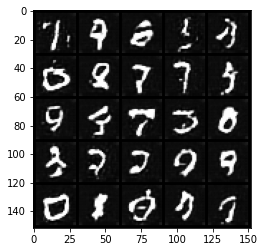

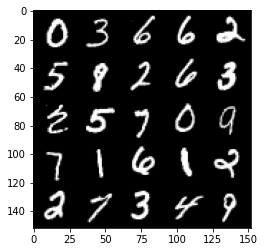

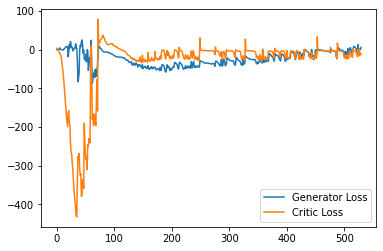

Step 10650: Generator loss: -0.5784184813499451, critic loss: -18.777647802352906


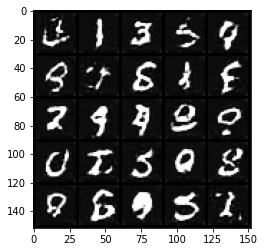

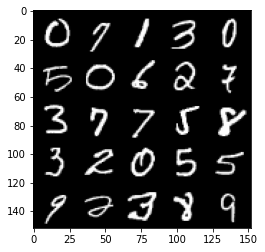

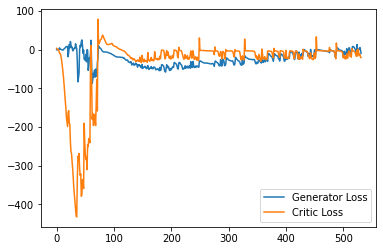

Step 10700: Generator loss: -1.3571173167228698, critic loss: -16.23936219620704


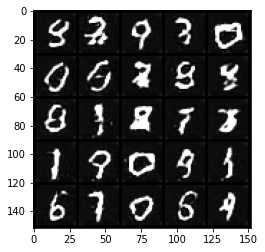

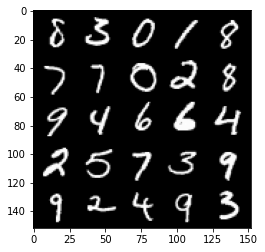

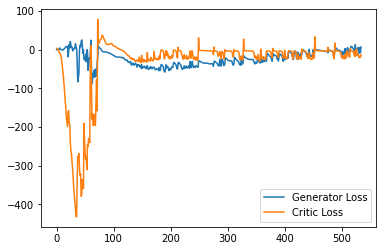

Step 10750: Generator loss: 3.744088035821915, critic loss: -14.867633562564851


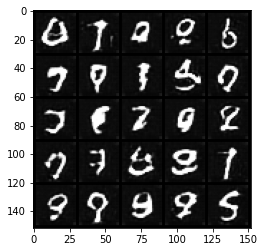

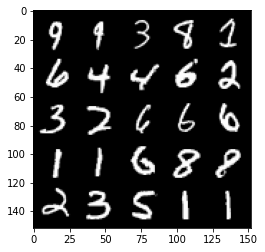

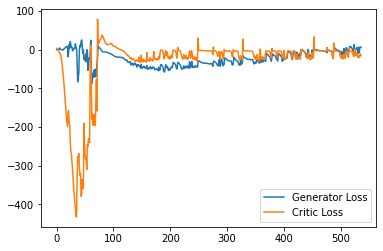

Step 10800: Generator loss: -6.3288161194324495, critic loss: -20.97938416051865


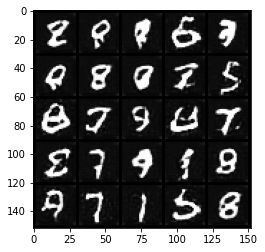

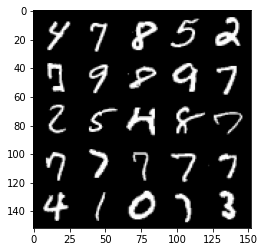

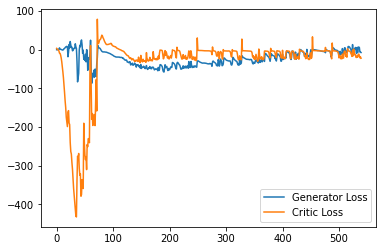

Step 10850: Generator loss: 1.3740480363368988, critic loss: -18.43733104515076


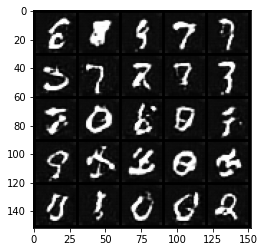

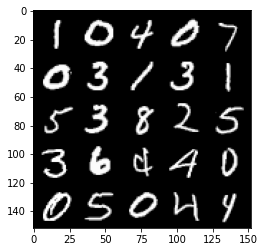

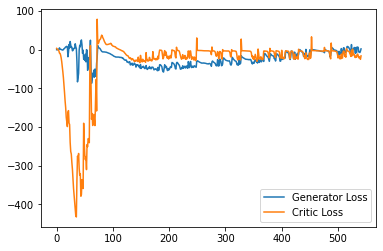

Step 10900: Generator loss: -2.6824451822042463, critic loss: -20.638791611194616


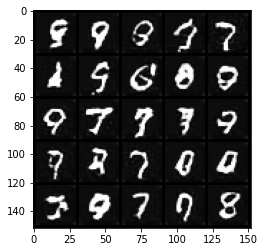

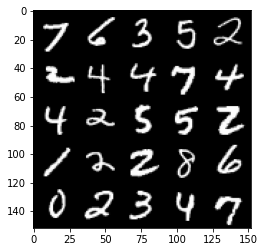

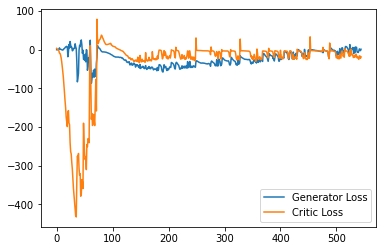

Step 10950: Generator loss: -2.497950614690781, critic loss: -17.8875908613205


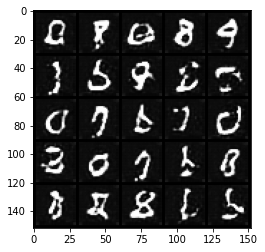

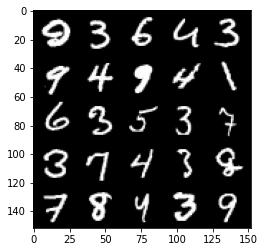

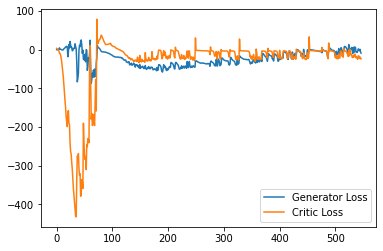

Step 11000: Generator loss: 10.39667313992977, critic loss: -14.13297813463211


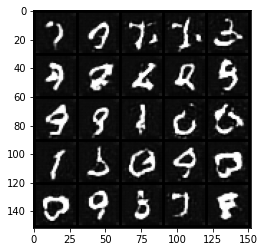

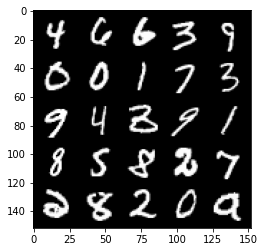

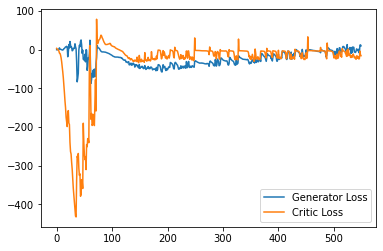

Step 11050: Generator loss: 0.414839551448822, critic loss: -19.333242053747178


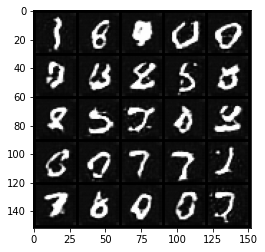

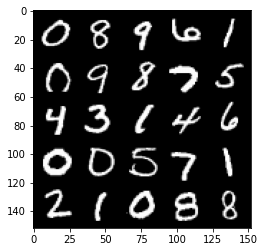

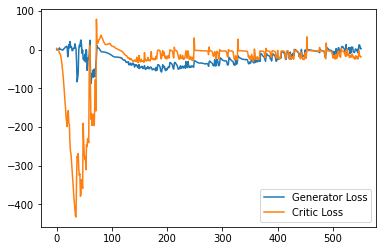

Step 11100: Generator loss: 6.907556736469269, critic loss: -3.266136015415187


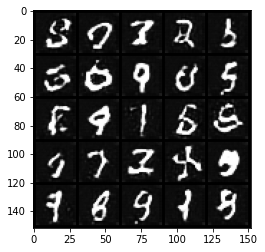

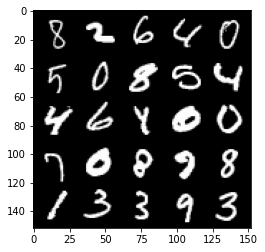

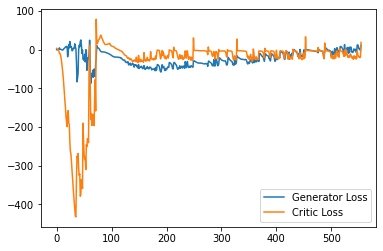

Step 11150: Generator loss: 14.014299907684325, critic loss: -2.6048787302970893


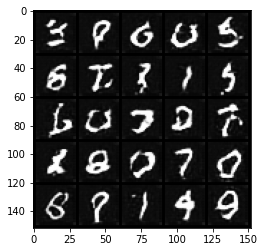

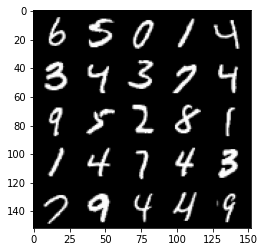

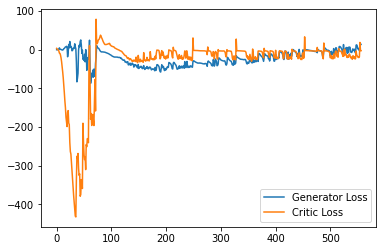

Step 11200: Generator loss: 13.360611171722413, critic loss: -3.3217940053939823


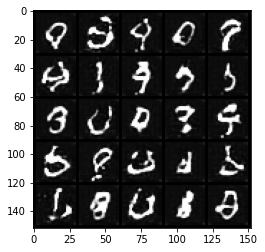

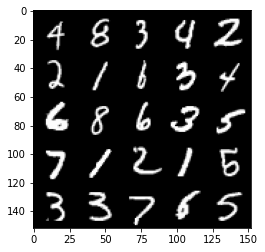

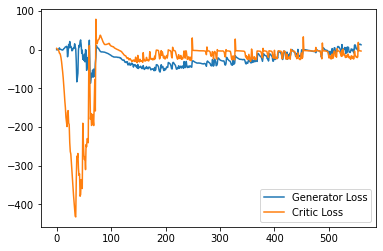

Step 11250: Generator loss: 4.991397134661675, critic loss: -9.83353903222084


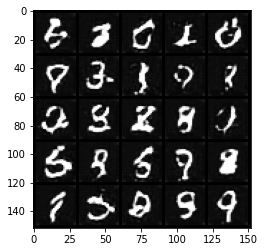

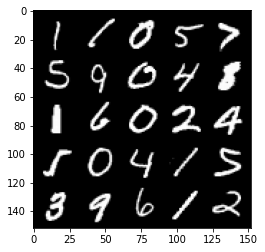

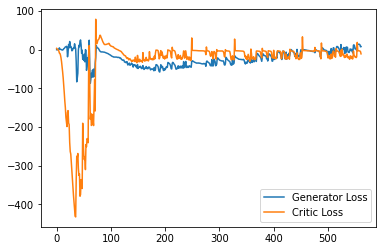

Step 11300: Generator loss: 9.50409474492073, critic loss: -7.932763044834135


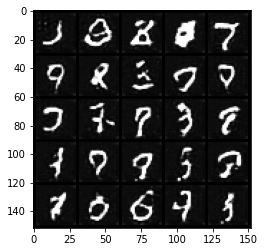

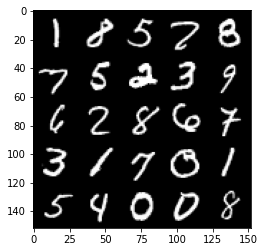

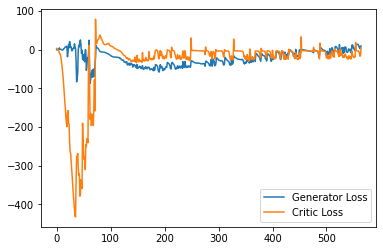

Step 11350: Generator loss: 10.099559253454208, critic loss: -18.72243473994732


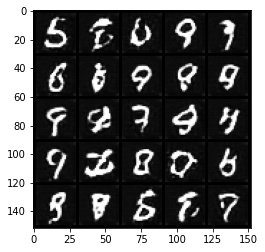

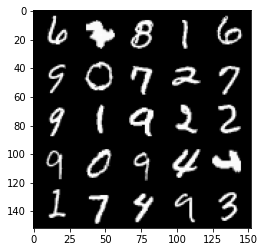

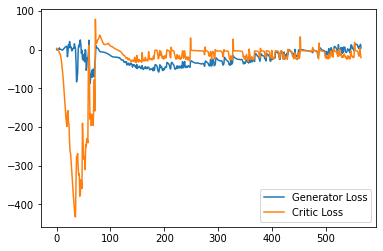

Step 11400: Generator loss: 7.855966883897781, critic loss: -17.27119338703156


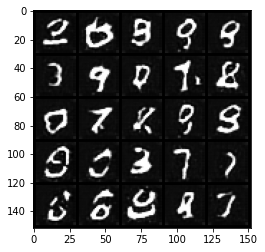

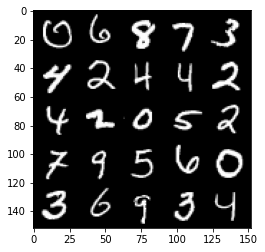

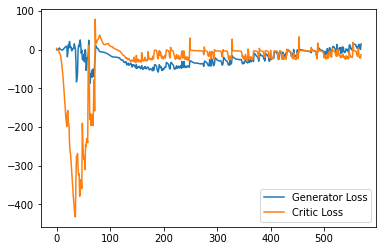

Step 11450: Generator loss: 6.722215507030487, critic loss: -16.991562691688536


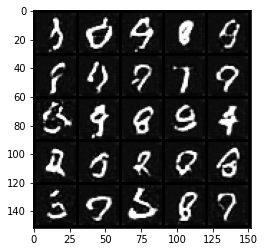

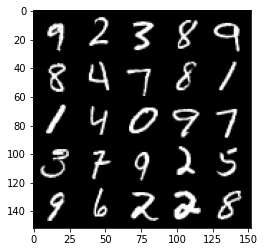

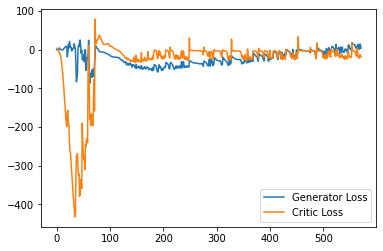

Step 11500: Generator loss: 7.845834838747979, critic loss: -16.80883916854858


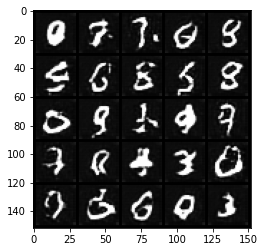

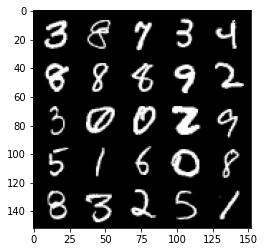

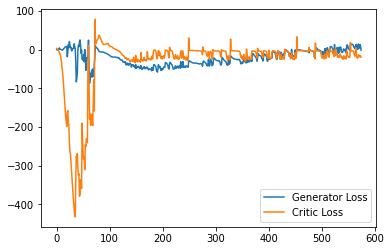

Step 11550: Generator loss: 10.934129905700683, critic loss: -15.766773407459256


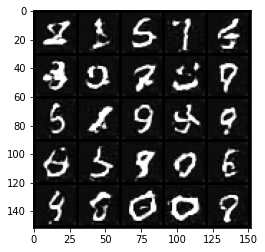

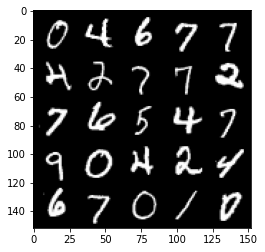

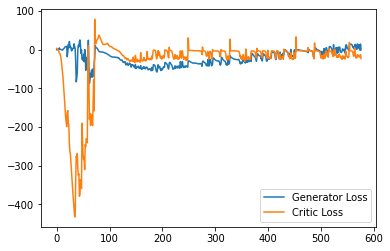

Step 11600: Generator loss: 11.483216681480407, critic loss: -9.825808012485503


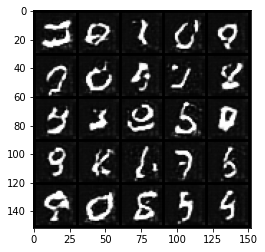

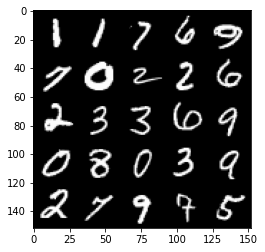

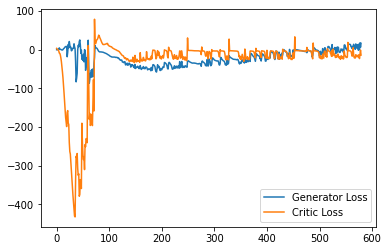

Step 11650: Generator loss: 8.643227987289428, critic loss: -18.118087707519532


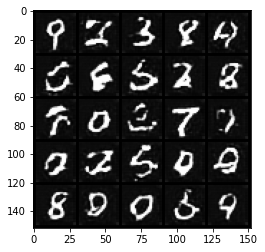

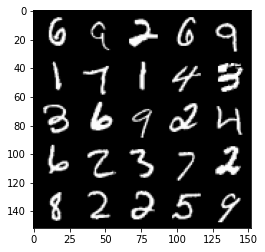

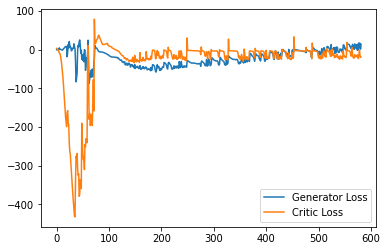

Step 11700: Generator loss: 3.7943271231651305, critic loss: -19.51369015741348


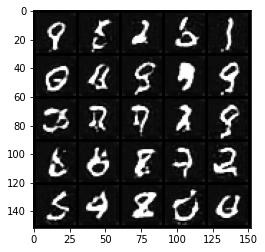

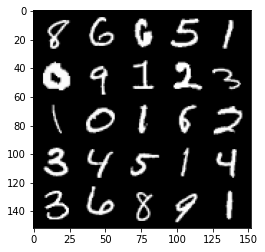

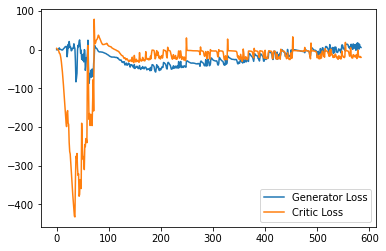

Step 11750: Generator loss: 10.996469532251359, critic loss: -18.15428839993477


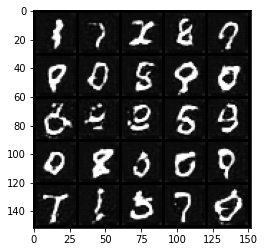

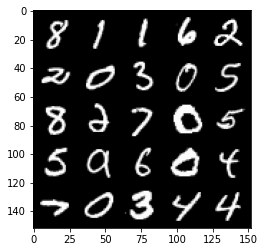

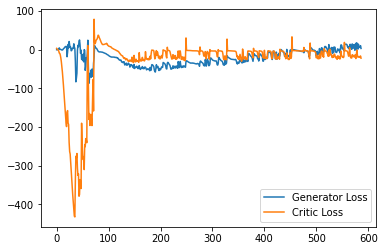

Step 11800: Generator loss: 13.44607853114605, critic loss: -16.092597967624666


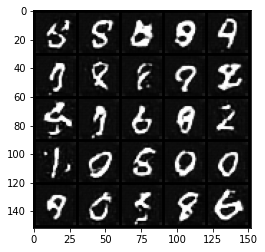

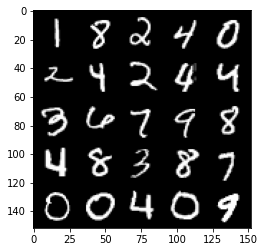

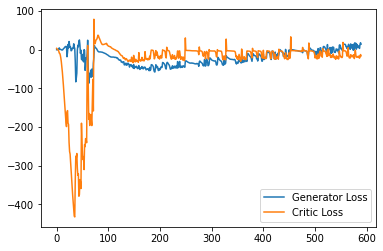

Step 11850: Generator loss: 8.887310128509998, critic loss: -22.189158288002012


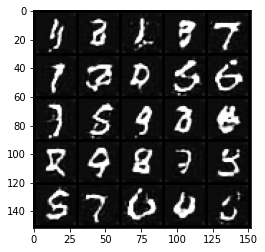

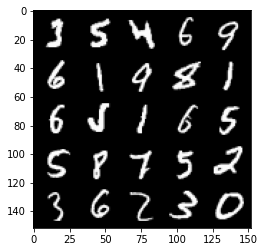

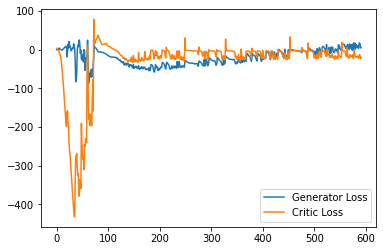

Step 11900: Generator loss: 5.4590202331542965, critic loss: -19.97904486131668


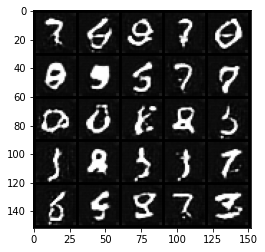

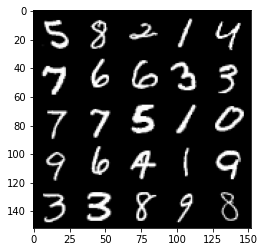

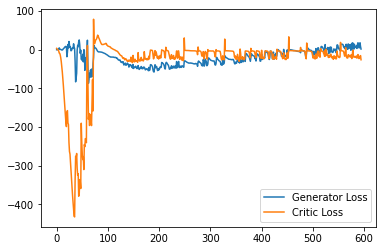

Step 11950: Generator loss: 14.499660312831402, critic loss: -13.340761473178864


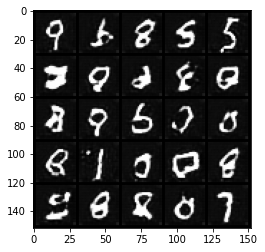

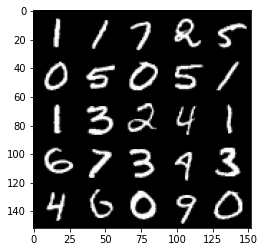

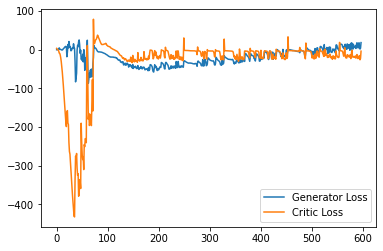

Step 12000: Generator loss: 17.59265703678131, critic loss: -13.565095806598658


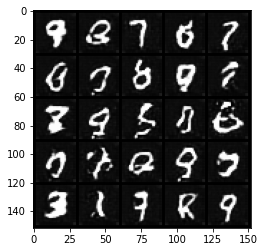

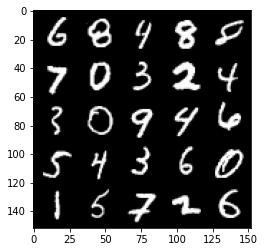

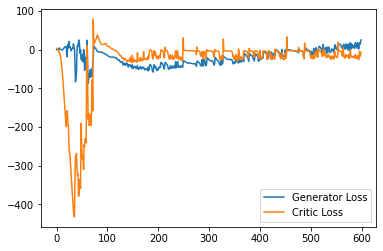

Step 12050: Generator loss: 11.626875289678573, critic loss: -21.45489985322952


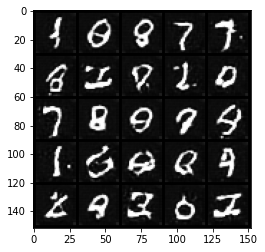

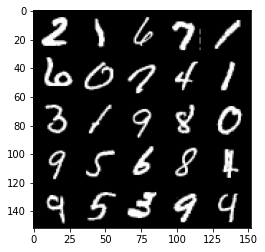

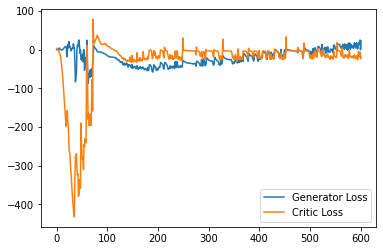

Step 12100: Generator loss: 14.784905843734741, critic loss: -19.668133287906652


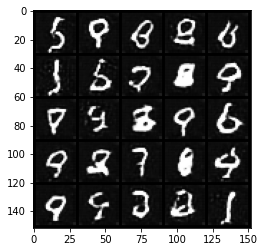

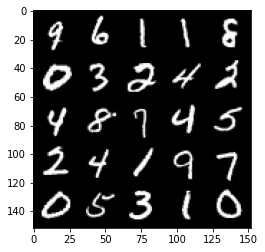

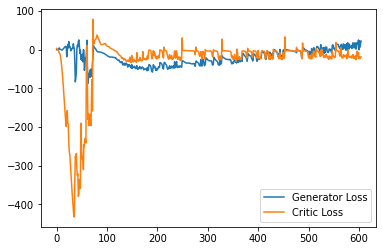

Step 12150: Generator loss: 10.812469552159309, critic loss: -8.994689857006076


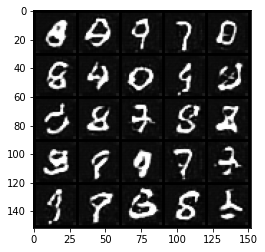

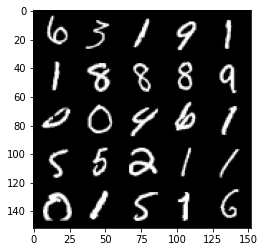

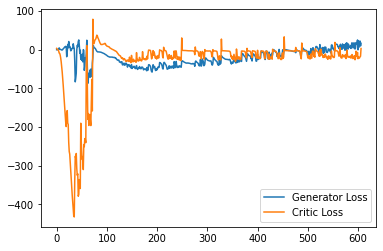

Step 12200: Generator loss: 14.523256693482399, critic loss: -15.708440907239913


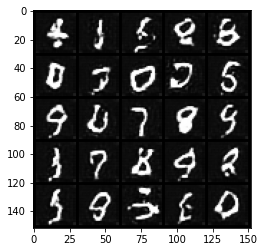

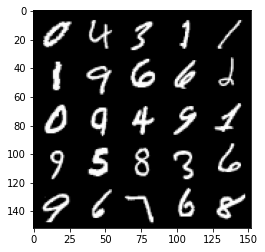

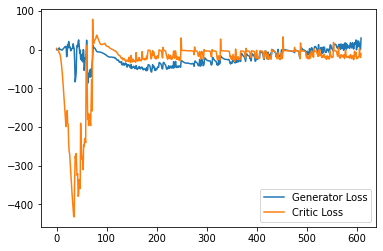

Step 12250: Generator loss: 18.72886915206909, critic loss: -16.18045927929878


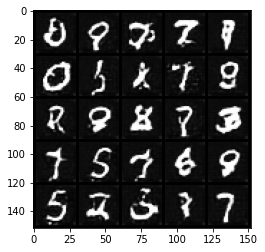

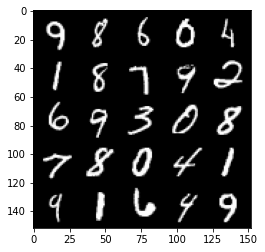

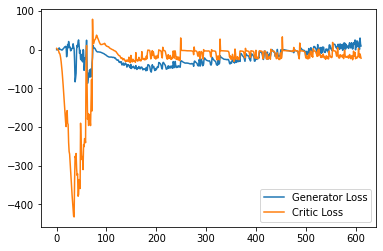

Step 12300: Generator loss: 19.454125537872315, critic loss: -11.160466472625728


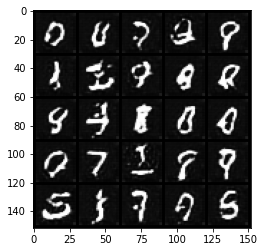

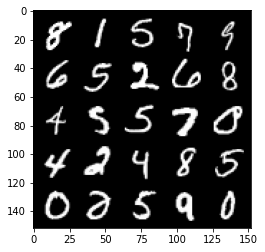

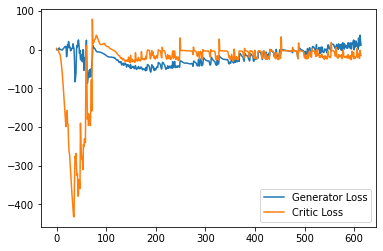

Step 12350: Generator loss: 16.594686267375945, critic loss: -16.60738107395172


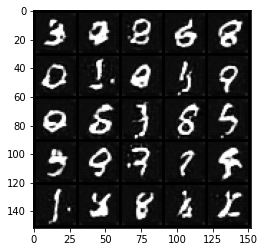

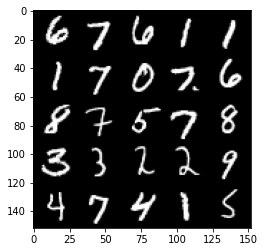

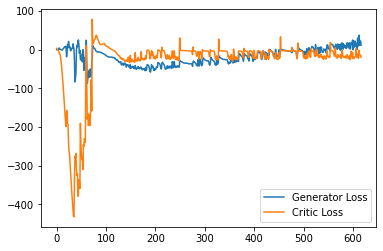

Step 12400: Generator loss: 15.508357067108154, critic loss: -6.791492701053613


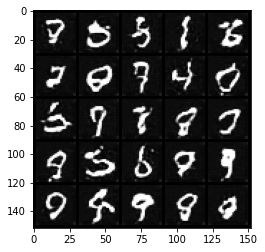

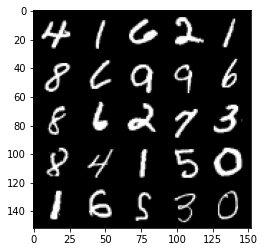

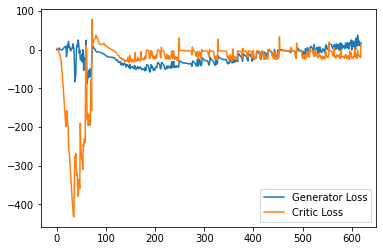

Step 12450: Generator loss: 25.885717239379883, critic loss: -3.3395072972774504


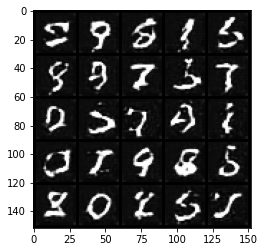

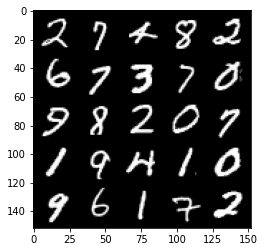

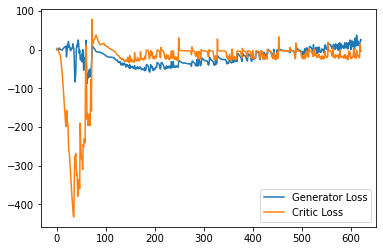

Step 12500: Generator loss: 23.67372299194336, critic loss: -4.9739383435249325


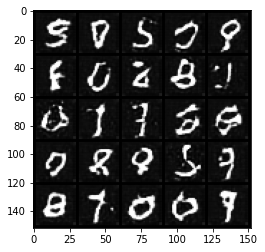

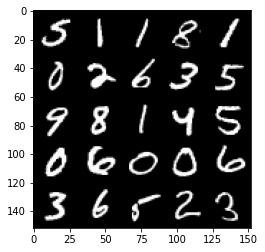

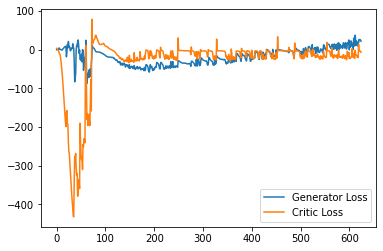

Step 12550: Generator loss: 18.515743739008904, critic loss: -16.682901493072507


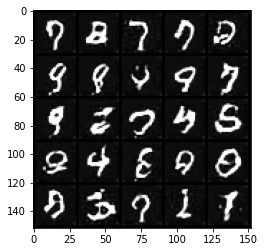

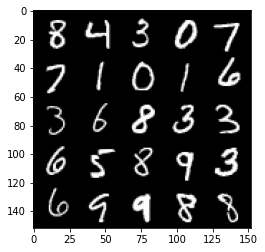

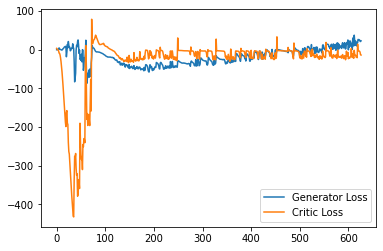

Step 12600: Generator loss: 16.46422038793564, critic loss: -23.192545914173127


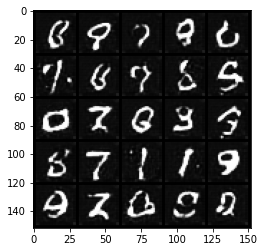

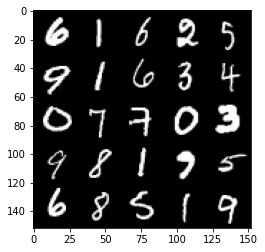

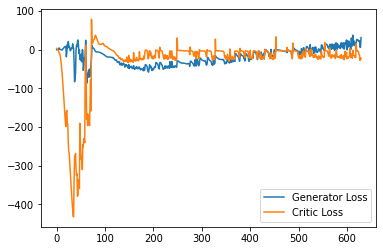

Step 12650: Generator loss: 17.893281333446502, critic loss: -14.366102609157563


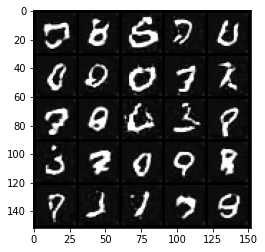

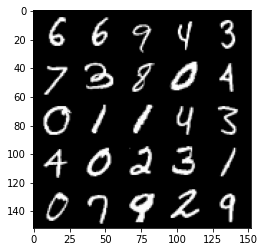

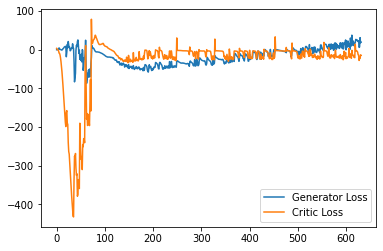

Step 12700: Generator loss: 12.063757807016373, critic loss: -23.130422886371615


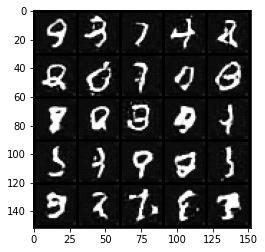

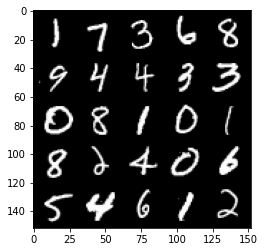

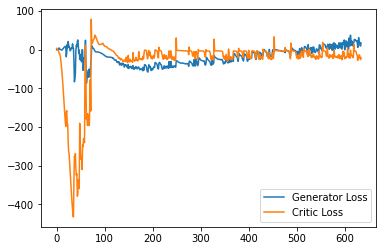

Step 12750: Generator loss: 17.821211842298506, critic loss: -8.499869635105131


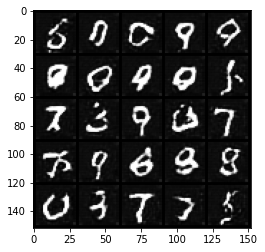

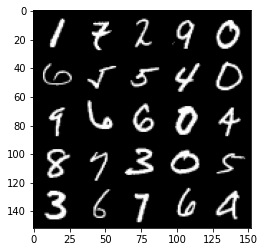

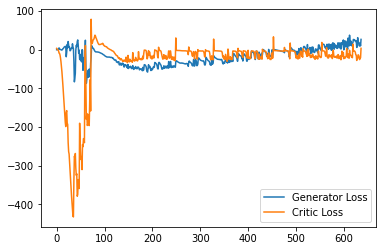

Step 12800: Generator loss: 17.201744817495346, critic loss: -18.17078458309174


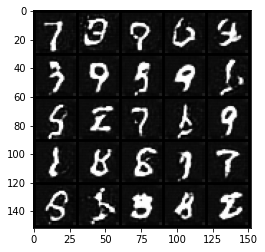

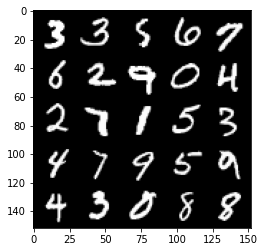

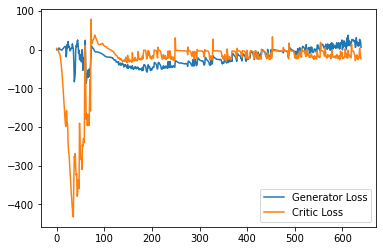

Step 12850: Generator loss: 18.534161834716798, critic loss: -21.71549860286713


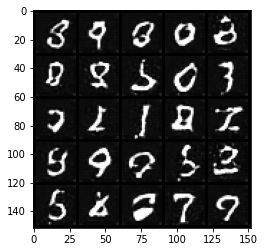

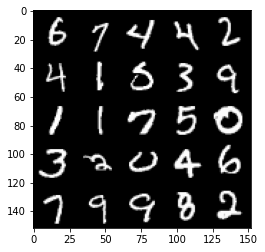

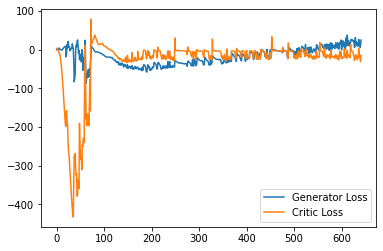

Step 12900: Generator loss: 19.169810637235642, critic loss: -20.486101175546647


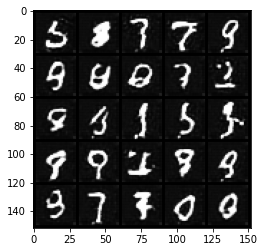

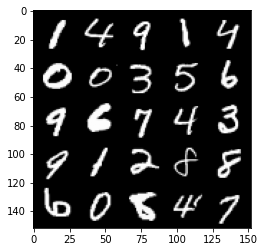

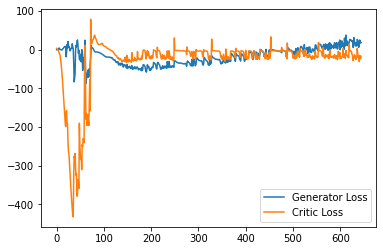

Step 12950: Generator loss: 23.91427171945572, critic loss: -10.091603696346281


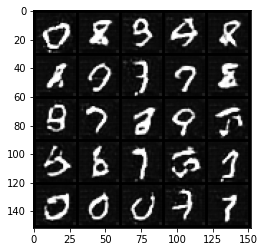

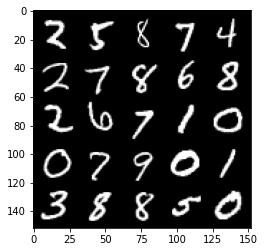

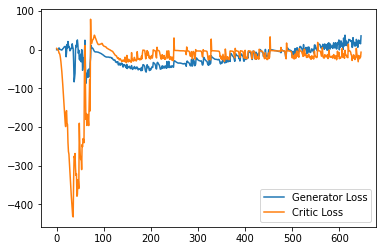

Step 13000: Generator loss: 24.711921796798705, critic loss: -8.200312585830687


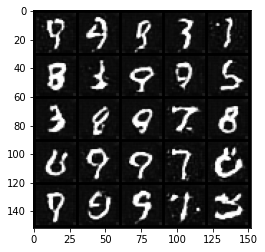

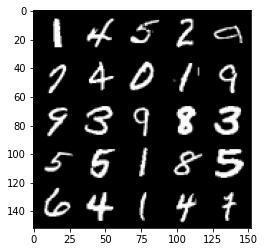

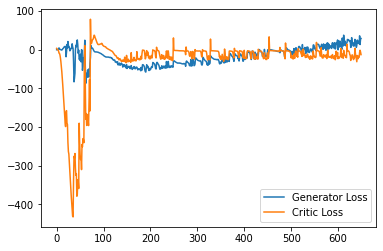

Step 13050: Generator loss: 26.129706594944, critic loss: -18.03326811623573


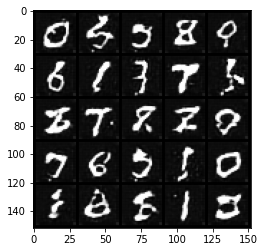

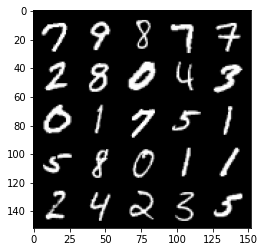

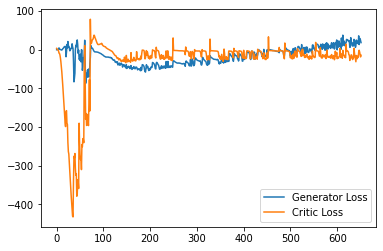

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
